<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_def.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
!pip install --upgrade tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
len(X_train)

919

In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [17]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [18]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_EFFNET/model_EFFNET.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    include_optimizer=False,
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
effnet = EfficientNetV2B0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

24274472/24274472 [==============================] - 1s 0us/step


In [24]:
def get_config(self):
    config = super().get_config()
    return config

In [25]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/150
52/52 [==============================] - ETA: 0s - loss: 48.7998 - IoU: 6.1918e-04
Epoch 1: val_loss improved from inf to 31.77061, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


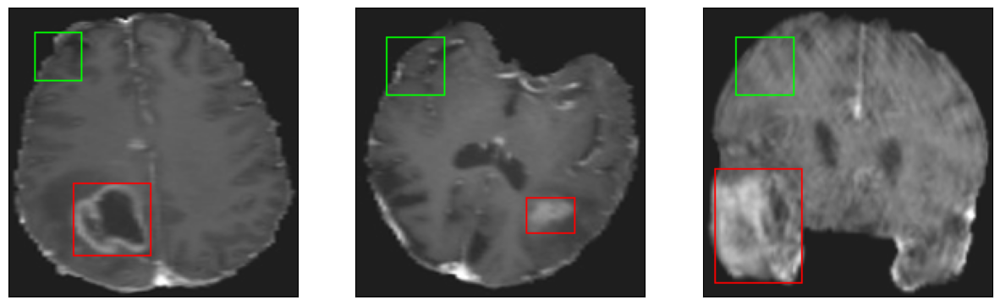

52/52 [==============================] - 84s 326ms/step - loss: 48.7998 - IoU: 6.1918e-04 - val_loss: 31.7706 - val_IoU: 0.0236
Epoch 2/150
52/52 [==============================] - ETA: 0s - loss: 28.7587 - IoU: 0.0435
Epoch 2: val_loss improved from 31.77061 to 24.02907, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


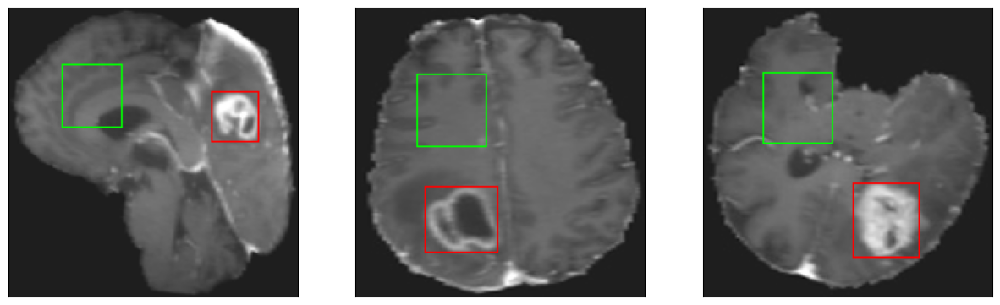

52/52 [==============================] - 9s 171ms/step - loss: 28.7587 - IoU: 0.0435 - val_loss: 24.0291 - val_IoU: 0.0693
Epoch 3/150
52/52 [==============================] - ETA: 0s - loss: 20.4055 - IoU: 0.1020
Epoch 3: val_loss improved from 24.02907 to 18.42798, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


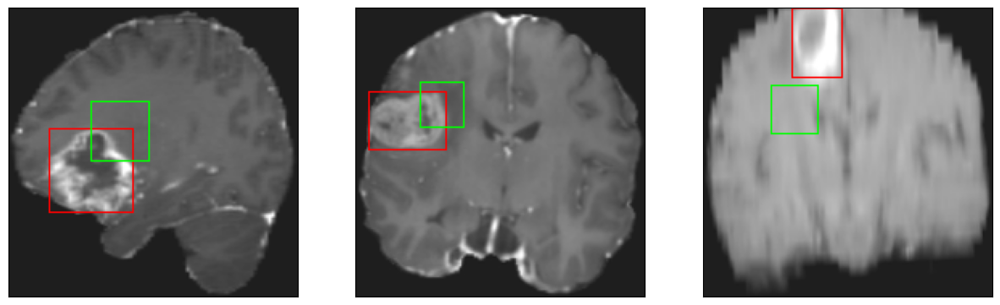

52/52 [==============================] - 7s 143ms/step - loss: 20.4055 - IoU: 0.1020 - val_loss: 18.4280 - val_IoU: 0.1059
Epoch 4/150
52/52 [==============================] - ETA: 0s - loss: 17.7844 - IoU: 0.1195
Epoch 4: val_loss improved from 18.42798 to 17.10965, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


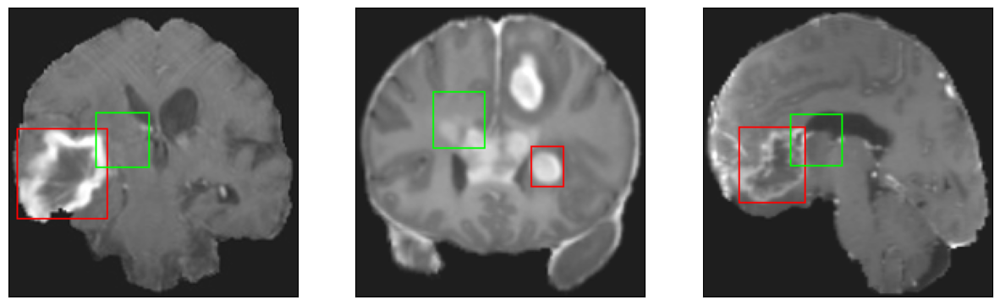

52/52 [==============================] - 7s 139ms/step - loss: 17.7844 - IoU: 0.1195 - val_loss: 17.1096 - val_IoU: 0.1368
Epoch 5/150
52/52 [==============================] - ETA: 0s - loss: 14.5452 - IoU: 0.1829
Epoch 5: val_loss improved from 17.10965 to 13.48309, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


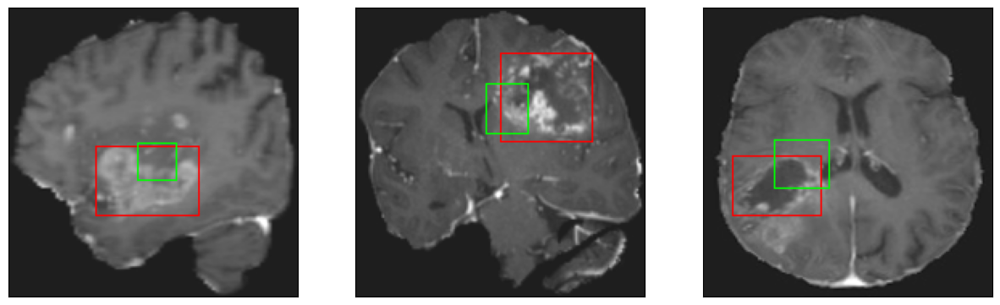

52/52 [==============================] - 8s 157ms/step - loss: 14.5452 - IoU: 0.1829 - val_loss: 13.4831 - val_IoU: 0.1778
Epoch 6/150
52/52 [==============================] - ETA: 0s - loss: 11.4824 - IoU: 0.2696
Epoch 6: val_loss improved from 13.48309 to 9.69708, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


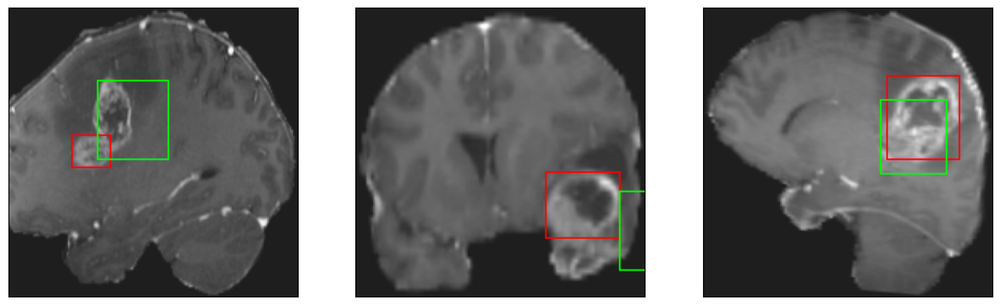

52/52 [==============================] - 7s 138ms/step - loss: 11.4824 - IoU: 0.2696 - val_loss: 9.6971 - val_IoU: 0.3129
Epoch 7/150
52/52 [==============================] - ETA: 0s - loss: 9.3719 - IoU: 0.3448
Epoch 7: val_loss improved from 9.69708 to 7.44453, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


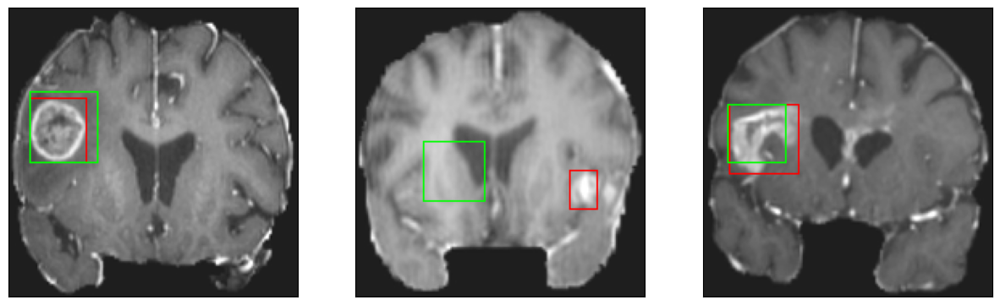

52/52 [==============================] - 8s 154ms/step - loss: 9.3719 - IoU: 0.3448 - val_loss: 7.4445 - val_IoU: 0.4488
Epoch 8/150
52/52 [==============================] - ETA: 0s - loss: 8.0046 - IoU: 0.4111
Epoch 8: val_loss improved from 7.44453 to 6.68497, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


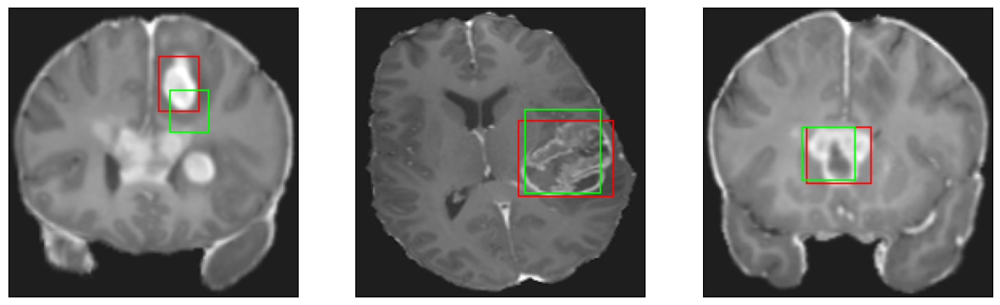

52/52 [==============================] - 8s 145ms/step - loss: 8.0046 - IoU: 0.4111 - val_loss: 6.6850 - val_IoU: 0.4743
Epoch 9/150
52/52 [==============================] - ETA: 0s - loss: 7.6660 - IoU: 0.4165
Epoch 9: val_loss improved from 6.68497 to 6.40441, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


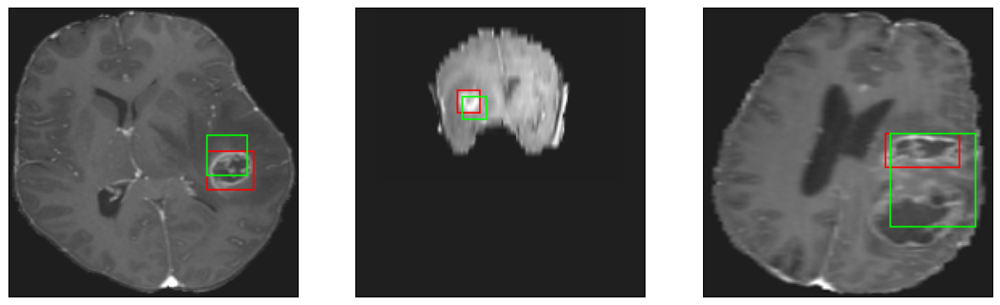

52/52 [==============================] - 8s 149ms/step - loss: 7.6660 - IoU: 0.4165 - val_loss: 6.4044 - val_IoU: 0.4922
Epoch 10/150
52/52 [==============================] - ETA: 0s - loss: 7.0565 - IoU: 0.4479
Epoch 10: val_loss did not improve from 6.40441
8/8 [==============================] - 0s 33ms/step


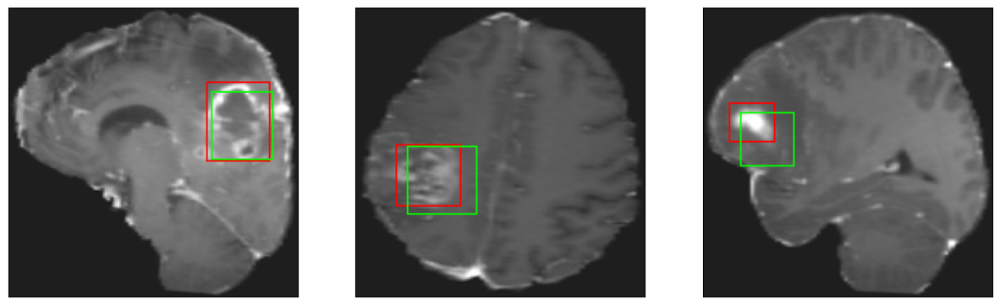

52/52 [==============================] - 6s 123ms/step - loss: 7.0565 - IoU: 0.4479 - val_loss: 7.3160 - val_IoU: 0.4288
Epoch 11/150
52/52 [==============================] - ETA: 0s - loss: 6.9047 - IoU: 0.4571
Epoch 11: val_loss improved from 6.40441 to 5.43680, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


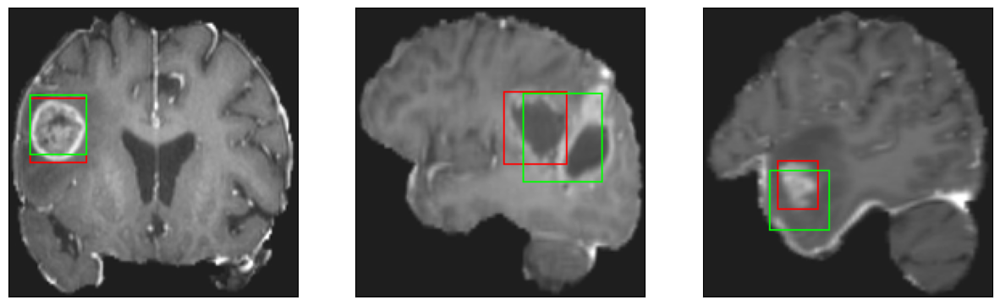

52/52 [==============================] - 9s 172ms/step - loss: 6.9047 - IoU: 0.4571 - val_loss: 5.4368 - val_IoU: 0.5828
Epoch 12/150
52/52 [==============================] - ETA: 0s - loss: 6.9659 - IoU: 0.4604
Epoch 12: val_loss did not improve from 5.43680
8/8 [==============================] - 0s 33ms/step


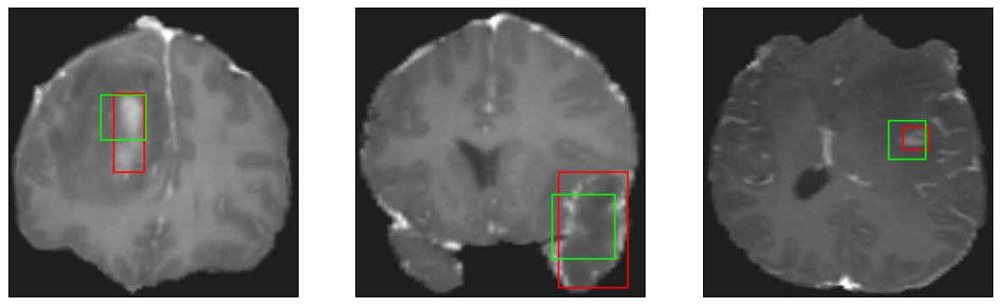

52/52 [==============================] - 6s 121ms/step - loss: 6.9659 - IoU: 0.4604 - val_loss: 5.7337 - val_IoU: 0.5585
Epoch 13/150
52/52 [==============================] - ETA: 0s - loss: 6.7764 - IoU: 0.4607
Epoch 13: val_loss did not improve from 5.43680
8/8 [==============================] - 0s 33ms/step


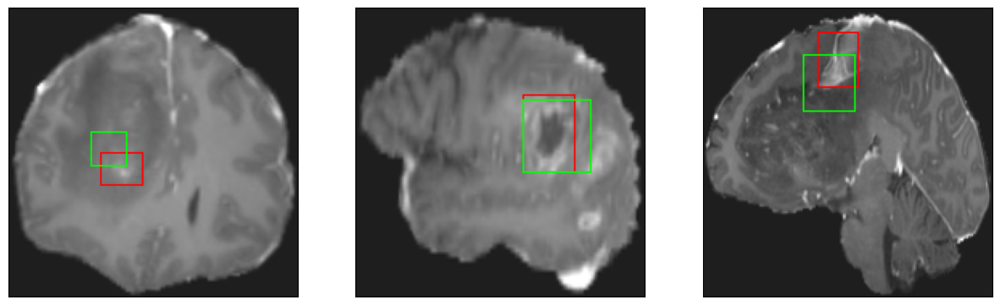

52/52 [==============================] - 7s 125ms/step - loss: 6.7764 - IoU: 0.4607 - val_loss: 5.7341 - val_IoU: 0.5784
Epoch 14/150
52/52 [==============================] - ETA: 0s - loss: 6.1731 - IoU: 0.5004
Epoch 14: val_loss did not improve from 5.43680
8/8 [==============================] - 0s 31ms/step


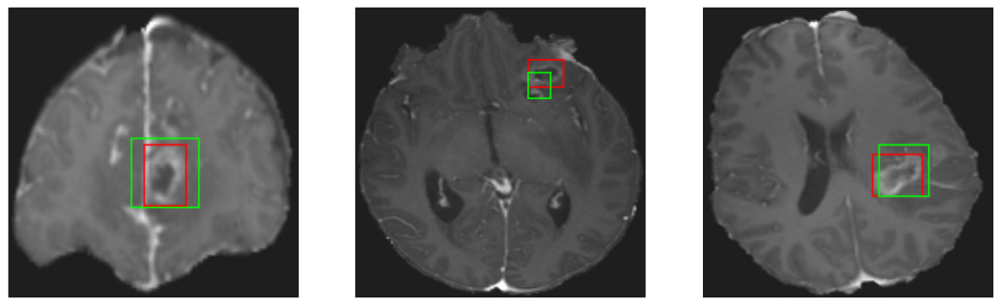

52/52 [==============================] - 6s 119ms/step - loss: 6.1731 - IoU: 0.5004 - val_loss: 6.4817 - val_IoU: 0.5088
Epoch 15/150
52/52 [==============================] - ETA: 0s - loss: 6.2442 - IoU: 0.5033
Epoch 15: val_loss did not improve from 5.43680
8/8 [==============================] - 0s 31ms/step


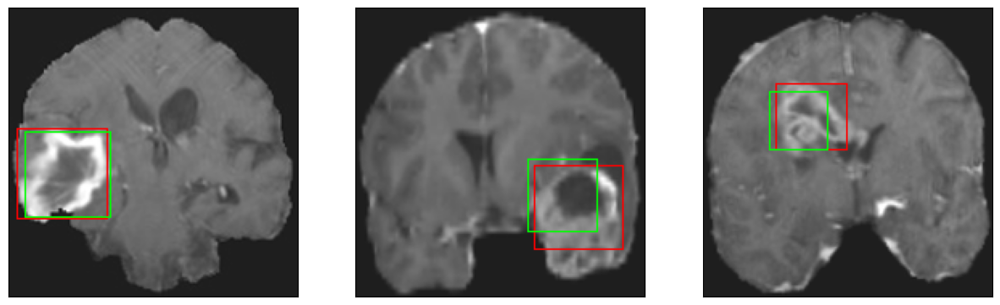

52/52 [==============================] - 7s 138ms/step - loss: 6.2442 - IoU: 0.5033 - val_loss: 6.6485 - val_IoU: 0.4618
Epoch 16/150
52/52 [==============================] - ETA: 0s - loss: 6.2676 - IoU: 0.4990
Epoch 16: val_loss did not improve from 5.43680
8/8 [==============================] - 0s 32ms/step


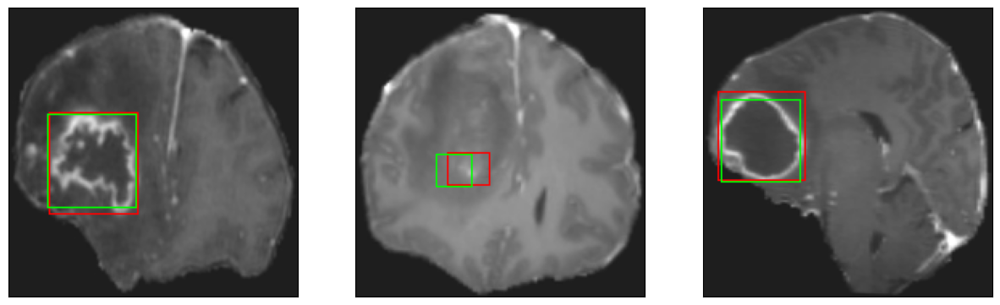

52/52 [==============================] - 7s 142ms/step - loss: 6.2676 - IoU: 0.4990 - val_loss: 5.4778 - val_IoU: 0.5746
Epoch 17/150
52/52 [==============================] - ETA: 0s - loss: 6.1082 - IoU: 0.5040
Epoch 17: val_loss did not improve from 5.43680
8/8 [==============================] - 0s 32ms/step


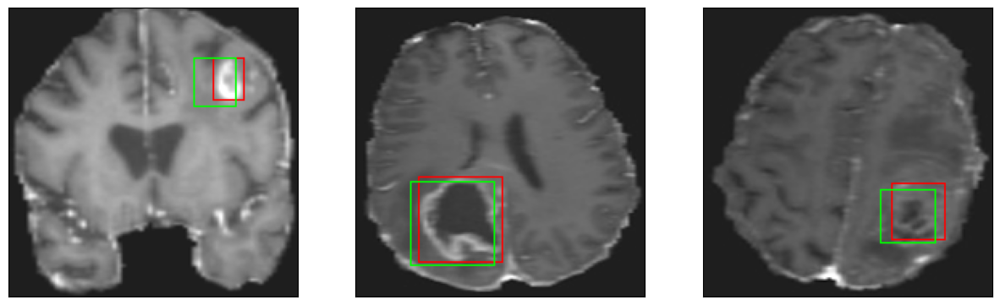

52/52 [==============================] - 6s 120ms/step - loss: 6.1082 - IoU: 0.5040 - val_loss: 5.6058 - val_IoU: 0.5774
Epoch 18/150
52/52 [==============================] - ETA: 0s - loss: 5.6814 - IoU: 0.5453
Epoch 18: val_loss improved from 5.43680 to 5.23675, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


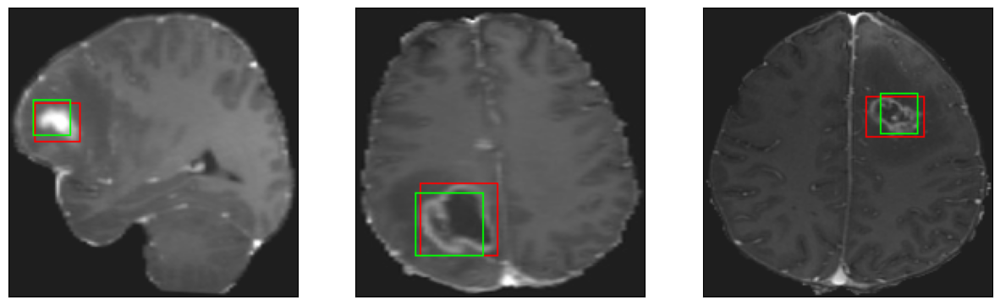

52/52 [==============================] - 10s 187ms/step - loss: 5.6814 - IoU: 0.5453 - val_loss: 5.2368 - val_IoU: 0.6102
Epoch 19/150
52/52 [==============================] - ETA: 0s - loss: 5.5676 - IoU: 0.5392
Epoch 19: val_loss improved from 5.23675 to 5.01742, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


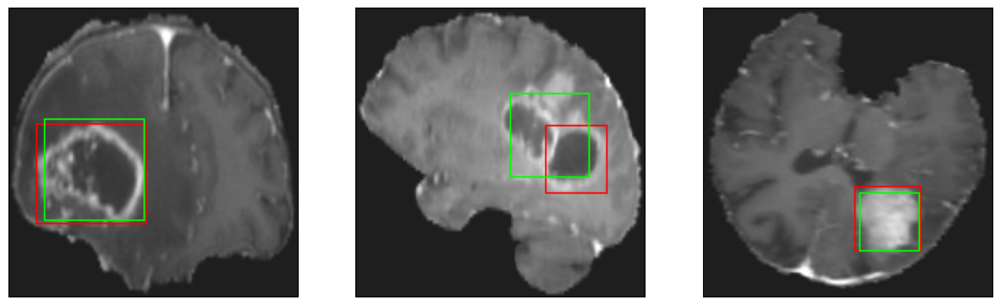

52/52 [==============================] - 8s 151ms/step - loss: 5.5676 - IoU: 0.5392 - val_loss: 5.0174 - val_IoU: 0.6157
Epoch 20/150
52/52 [==============================] - ETA: 0s - loss: 5.4114 - IoU: 0.5577
Epoch 20: val_loss improved from 5.01742 to 5.00798, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


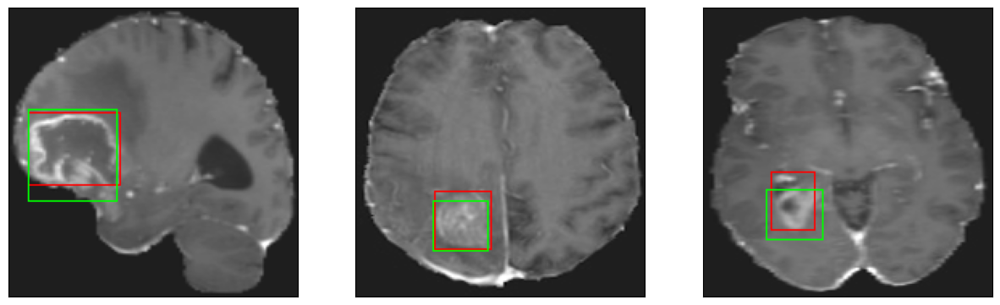

52/52 [==============================] - 9s 167ms/step - loss: 5.4114 - IoU: 0.5577 - val_loss: 5.0080 - val_IoU: 0.6291
Epoch 21/150
52/52 [==============================] - ETA: 0s - loss: 5.1807 - IoU: 0.5774
Epoch 21: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 35ms/step


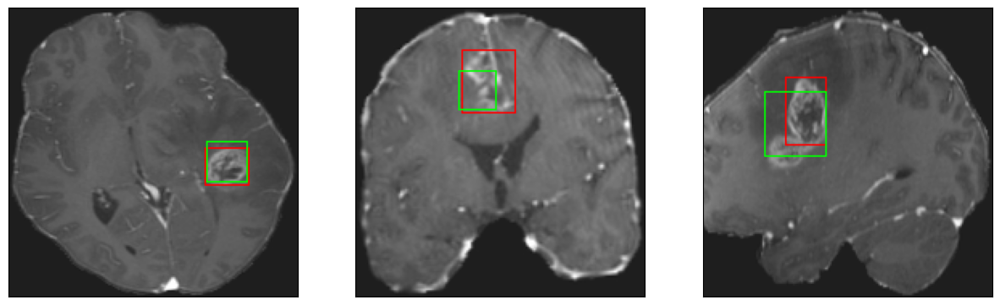

52/52 [==============================] - 7s 135ms/step - loss: 5.1807 - IoU: 0.5774 - val_loss: 5.6862 - val_IoU: 0.5638
Epoch 22/150
52/52 [==============================] - ETA: 0s - loss: 5.3024 - IoU: 0.5750
Epoch 22: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 33ms/step


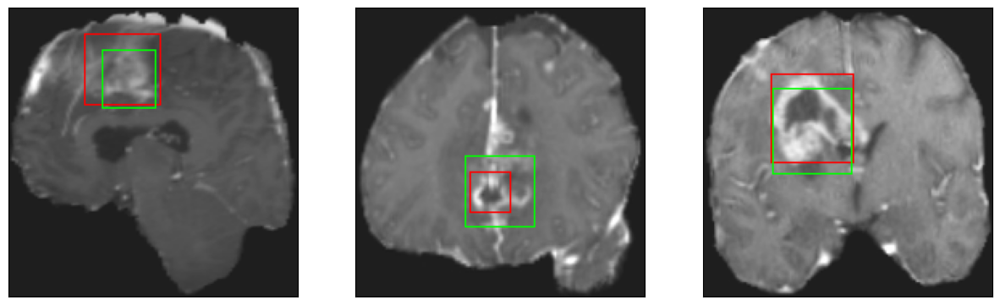

52/52 [==============================] - 7s 141ms/step - loss: 5.3024 - IoU: 0.5750 - val_loss: 5.6212 - val_IoU: 0.6059
Epoch 23/150
52/52 [==============================] - ETA: 0s - loss: 5.0497 - IoU: 0.5886
Epoch 23: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 32ms/step


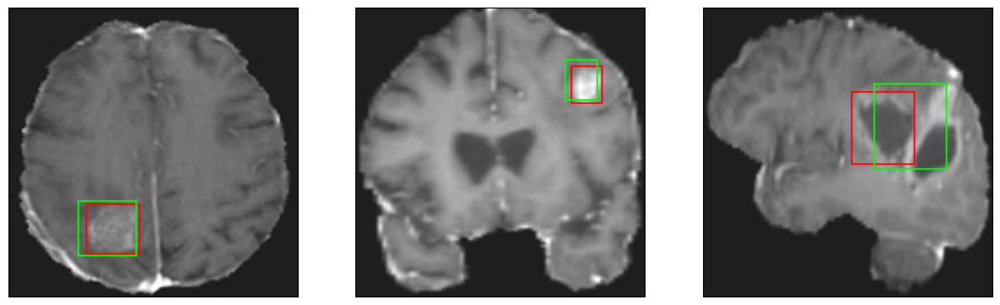

52/52 [==============================] - 6s 124ms/step - loss: 5.0497 - IoU: 0.5886 - val_loss: 5.2107 - val_IoU: 0.6145
Epoch 24/150
52/52 [==============================] - ETA: 0s - loss: 5.0146 - IoU: 0.5919
Epoch 24: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 32ms/step


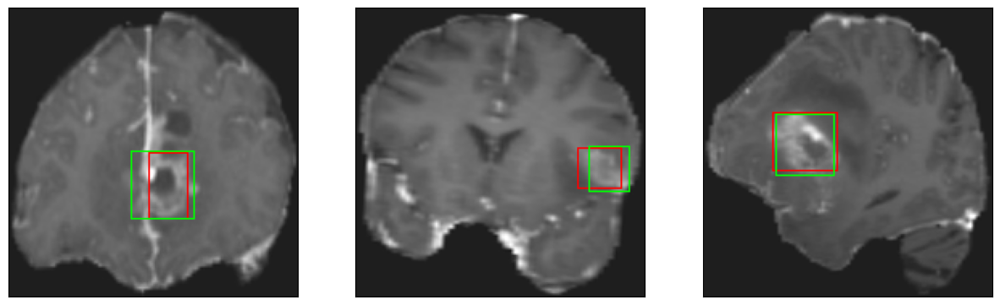

52/52 [==============================] - 8s 150ms/step - loss: 5.0146 - IoU: 0.5919 - val_loss: 5.0449 - val_IoU: 0.6263
Epoch 25/150
52/52 [==============================] - ETA: 0s - loss: 5.2691 - IoU: 0.5791
Epoch 25: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 31ms/step


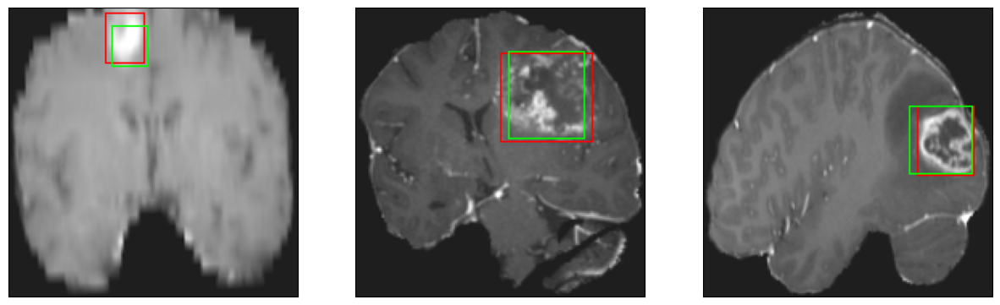

52/52 [==============================] - 6s 124ms/step - loss: 5.2691 - IoU: 0.5791 - val_loss: 5.2226 - val_IoU: 0.5990
Epoch 26/150
52/52 [==============================] - ETA: 0s - loss: 5.1591 - IoU: 0.5854
Epoch 26: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 32ms/step


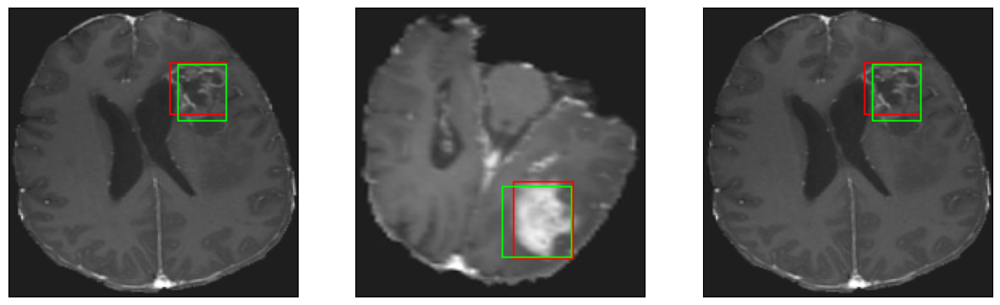

52/52 [==============================] - 8s 146ms/step - loss: 5.1591 - IoU: 0.5854 - val_loss: 5.3054 - val_IoU: 0.5920
Epoch 27/150
52/52 [==============================] - ETA: 0s - loss: 4.8008 - IoU: 0.6111
Epoch 27: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 32ms/step


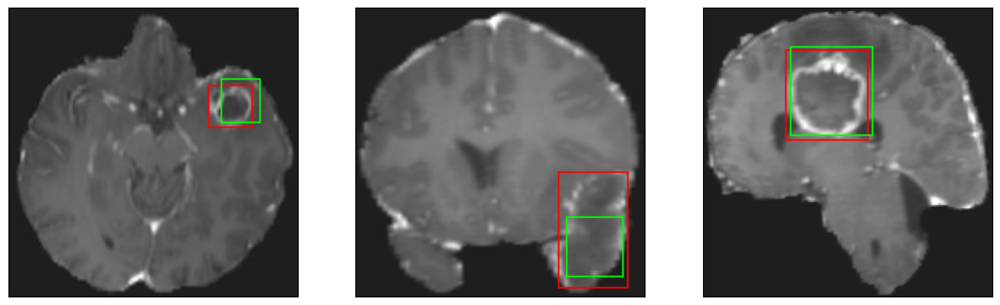

52/52 [==============================] - 7s 134ms/step - loss: 4.8008 - IoU: 0.6111 - val_loss: 5.3688 - val_IoU: 0.5891
Epoch 28/150
52/52 [==============================] - ETA: 0s - loss: 4.7923 - IoU: 0.6045
Epoch 28: val_loss did not improve from 5.00798
8/8 [==============================] - 0s 33ms/step


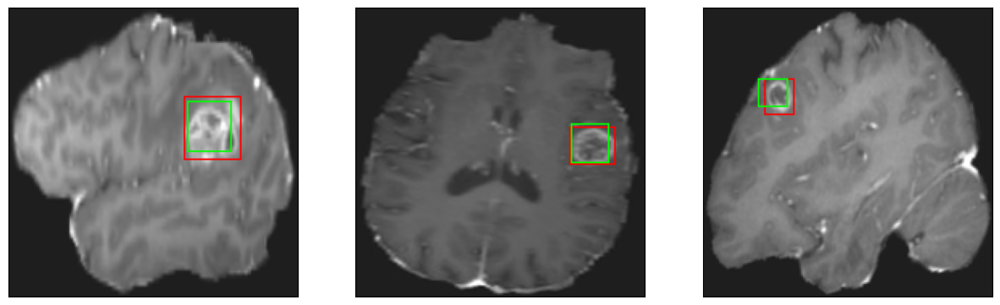

52/52 [==============================] - 8s 149ms/step - loss: 4.7923 - IoU: 0.6045 - val_loss: 5.6157 - val_IoU: 0.5845
Epoch 29/150
52/52 [==============================] - ETA: 0s - loss: 4.8947 - IoU: 0.6059
Epoch 29: val_loss improved from 5.00798 to 4.92812, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


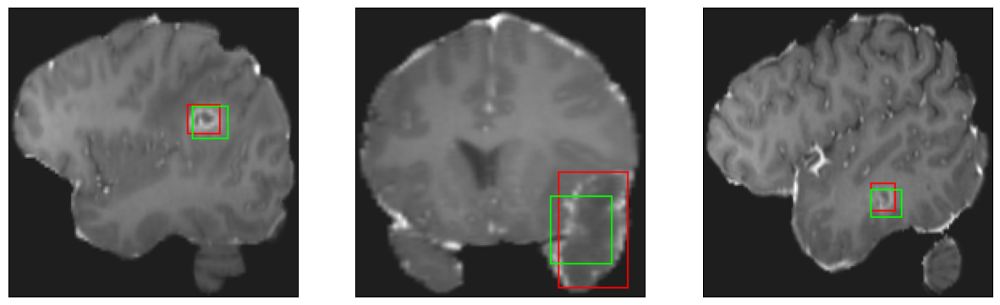

52/52 [==============================] - 9s 167ms/step - loss: 4.8947 - IoU: 0.6059 - val_loss: 4.9281 - val_IoU: 0.6243
Epoch 30/150
52/52 [==============================] - ETA: 0s - loss: 4.7224 - IoU: 0.6154
Epoch 30: val_loss did not improve from 4.92812
8/8 [==============================] - 0s 33ms/step


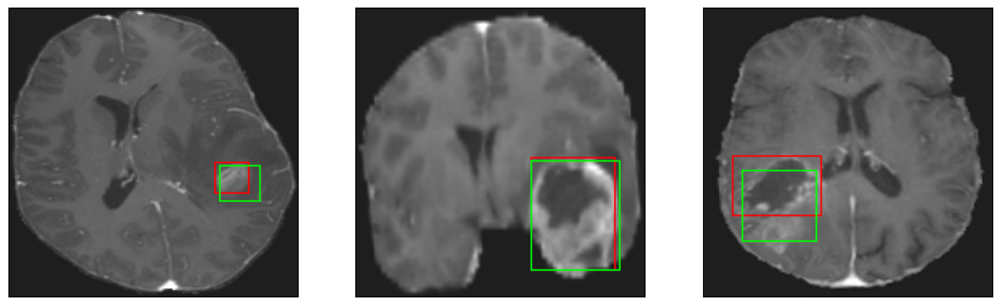

52/52 [==============================] - 8s 150ms/step - loss: 4.7224 - IoU: 0.6154 - val_loss: 5.0523 - val_IoU: 0.6208
Epoch 31/150
52/52 [==============================] - ETA: 0s - loss: 4.4650 - IoU: 0.6266
Epoch 31: val_loss did not improve from 4.92812
8/8 [==============================] - 0s 33ms/step


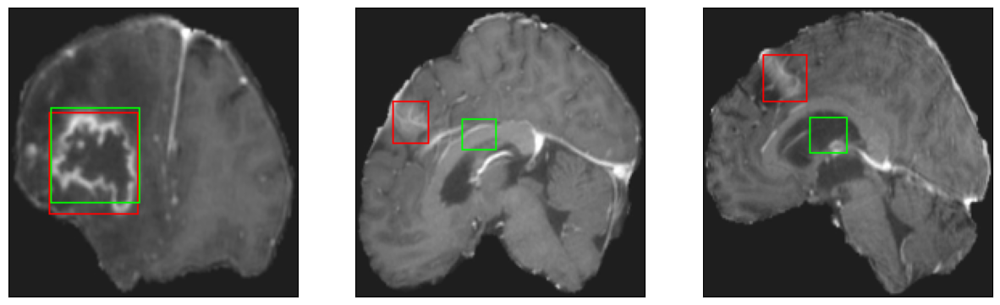

52/52 [==============================] - 7s 131ms/step - loss: 4.4650 - IoU: 0.6266 - val_loss: 5.0858 - val_IoU: 0.6096
Epoch 32/150
52/52 [==============================] - ETA: 0s - loss: 4.3242 - IoU: 0.6258
Epoch 32: val_loss did not improve from 4.92812
8/8 [==============================] - 0s 32ms/step


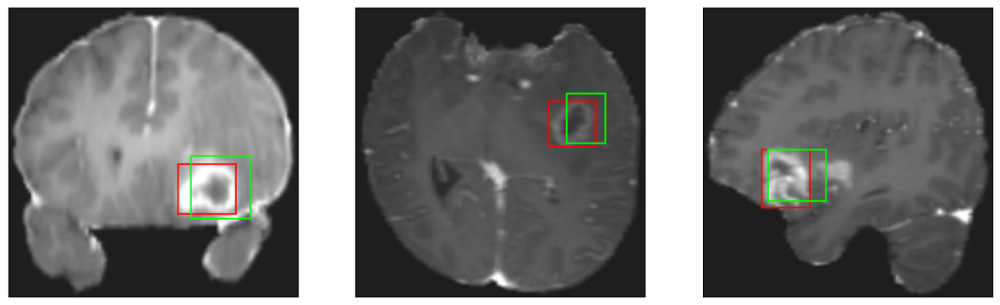

52/52 [==============================] - 7s 138ms/step - loss: 4.3242 - IoU: 0.6258 - val_loss: 4.9537 - val_IoU: 0.6131
Epoch 33/150
52/52 [==============================] - ETA: 0s - loss: 4.3893 - IoU: 0.6260
Epoch 33: val_loss did not improve from 4.92812
8/8 [==============================] - 0s 34ms/step


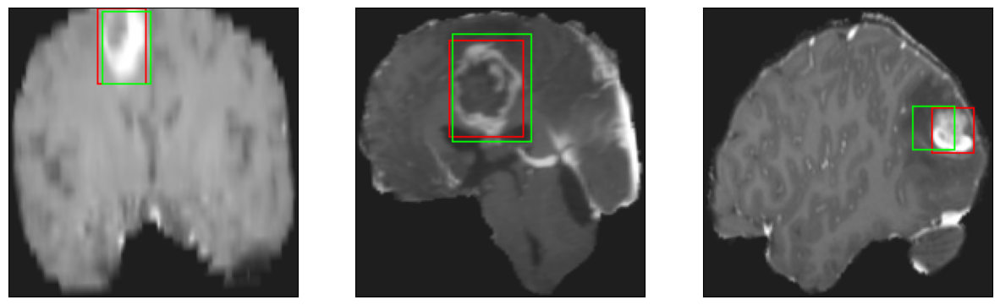

52/52 [==============================] - 7s 127ms/step - loss: 4.3893 - IoU: 0.6260 - val_loss: 5.1516 - val_IoU: 0.6136
Epoch 34/150
52/52 [==============================] - ETA: 0s - loss: 4.3062 - IoU: 0.6329
Epoch 34: val_loss did not improve from 4.92812
8/8 [==============================] - 0s 31ms/step


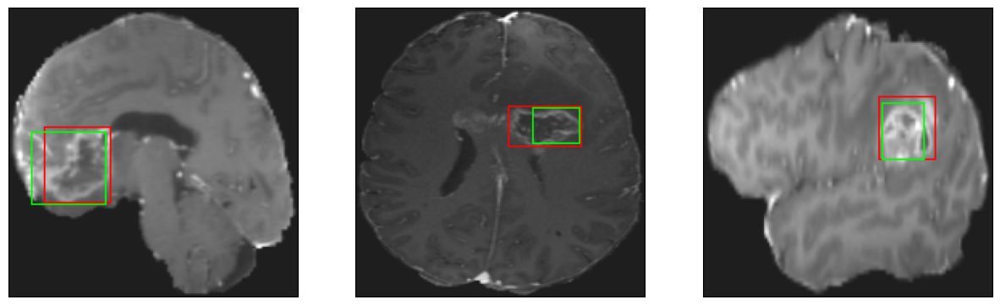

52/52 [==============================] - 7s 144ms/step - loss: 4.3062 - IoU: 0.6329 - val_loss: 5.1171 - val_IoU: 0.6148
Epoch 35/150
52/52 [==============================] - ETA: 0s - loss: 4.2461 - IoU: 0.6394
Epoch 35: val_loss improved from 4.92812 to 4.48246, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


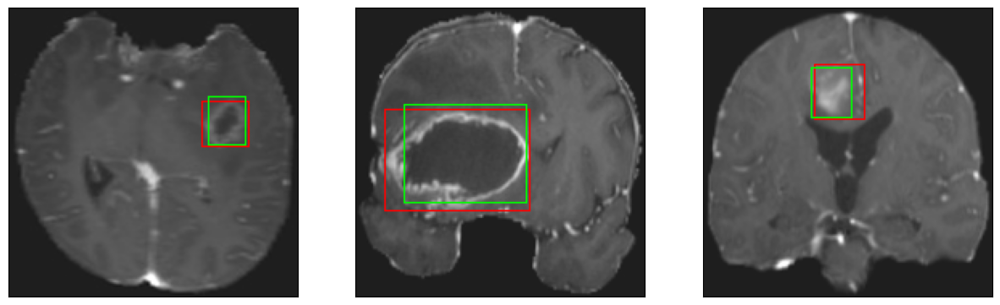

52/52 [==============================] - 9s 181ms/step - loss: 4.2461 - IoU: 0.6394 - val_loss: 4.4825 - val_IoU: 0.6735
Epoch 36/150
52/52 [==============================] - ETA: 0s - loss: 3.9767 - IoU: 0.6576
Epoch 36: val_loss did not improve from 4.48246
8/8 [==============================] - 0s 32ms/step


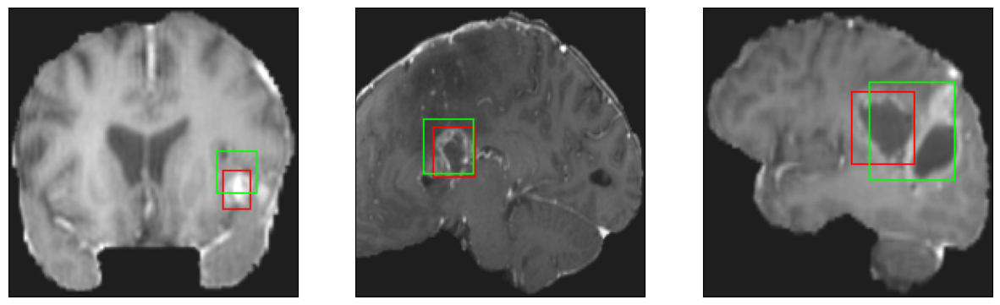

52/52 [==============================] - 8s 150ms/step - loss: 3.9767 - IoU: 0.6576 - val_loss: 5.2334 - val_IoU: 0.6082
Epoch 37/150
52/52 [==============================] - ETA: 0s - loss: 4.0184 - IoU: 0.6519
Epoch 37: val_loss did not improve from 4.48246
8/8 [==============================] - 0s 33ms/step


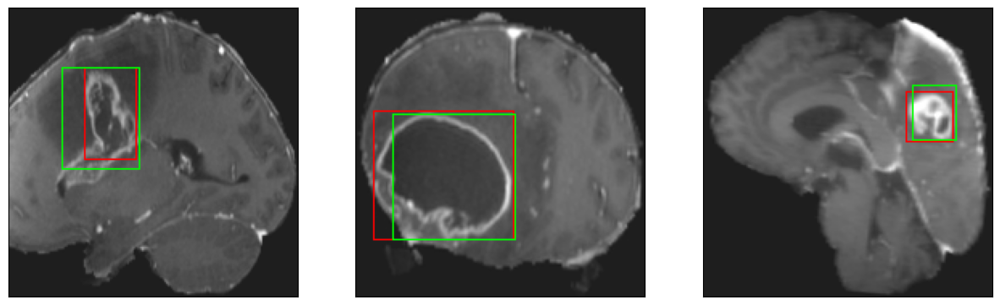

52/52 [==============================] - 7s 139ms/step - loss: 4.0184 - IoU: 0.6519 - val_loss: 4.6078 - val_IoU: 0.6541
Epoch 38/150
52/52 [==============================] - ETA: 0s - loss: 3.8211 - IoU: 0.6653
Epoch 38: val_loss did not improve from 4.48246
8/8 [==============================] - 0s 31ms/step


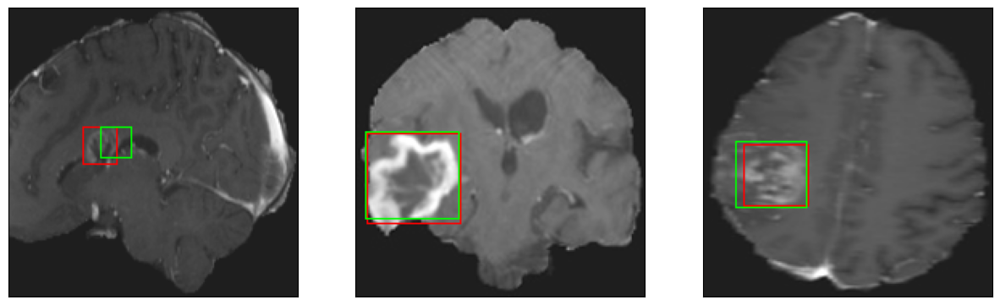

52/52 [==============================] - 7s 131ms/step - loss: 3.8211 - IoU: 0.6653 - val_loss: 4.9696 - val_IoU: 0.6049
Epoch 39/150
52/52 [==============================] - ETA: 0s - loss: 3.8677 - IoU: 0.6557
Epoch 39: val_loss improved from 4.48246 to 4.39876, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


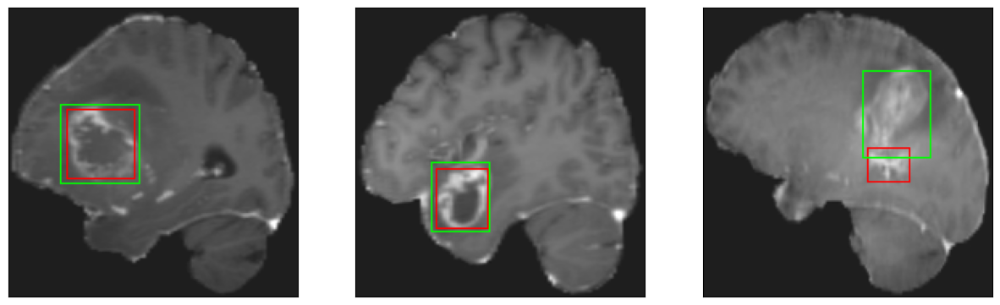

52/52 [==============================] - 10s 188ms/step - loss: 3.8677 - IoU: 0.6557 - val_loss: 4.3988 - val_IoU: 0.6830
Epoch 40/150
52/52 [==============================] - ETA: 0s - loss: 4.0614 - IoU: 0.6566
Epoch 40: val_loss did not improve from 4.39876
8/8 [==============================] - 0s 33ms/step


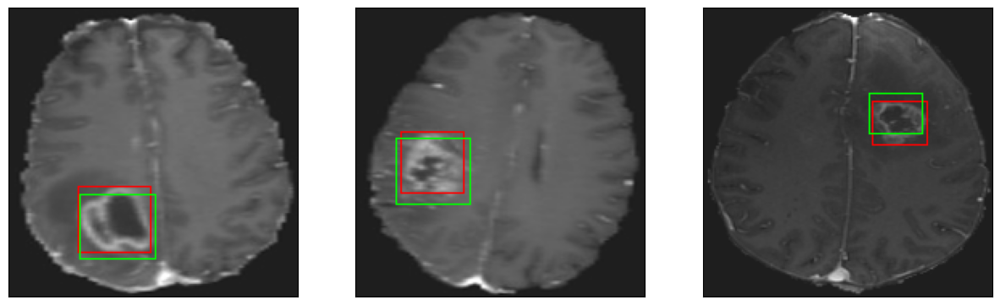

52/52 [==============================] - 7s 134ms/step - loss: 4.0614 - IoU: 0.6566 - val_loss: 4.5278 - val_IoU: 0.6648
Epoch 41/150
52/52 [==============================] - ETA: 0s - loss: 3.7785 - IoU: 0.6675
Epoch 41: val_loss did not improve from 4.39876
8/8 [==============================] - 0s 30ms/step


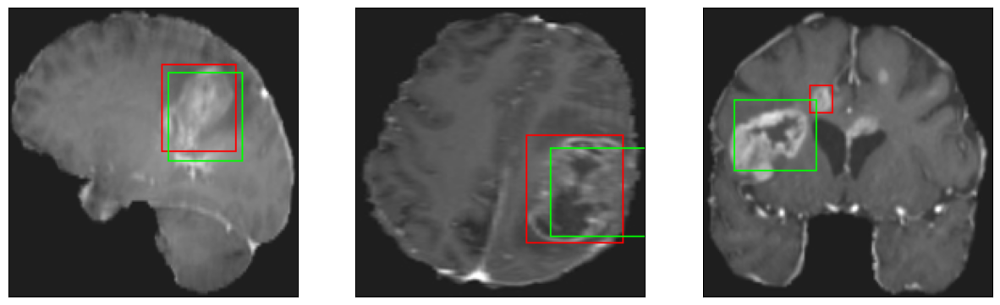

52/52 [==============================] - 7s 144ms/step - loss: 3.7785 - IoU: 0.6675 - val_loss: 5.0557 - val_IoU: 0.6428
Epoch 42/150
52/52 [==============================] - ETA: 0s - loss: 3.6526 - IoU: 0.6734
Epoch 42: val_loss did not improve from 4.39876
8/8 [==============================] - 0s 31ms/step


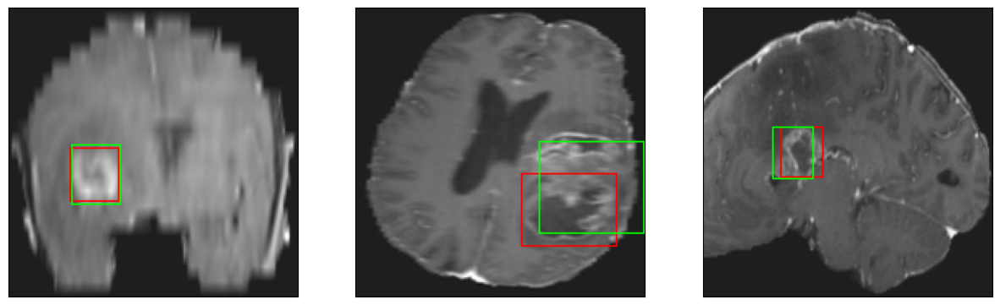

52/52 [==============================] - 7s 128ms/step - loss: 3.6526 - IoU: 0.6734 - val_loss: 4.6660 - val_IoU: 0.6429
Epoch 43/150
52/52 [==============================] - ETA: 0s - loss: 3.6698 - IoU: 0.6726
Epoch 43: val_loss did not improve from 4.39876
8/8 [==============================] - 0s 31ms/step


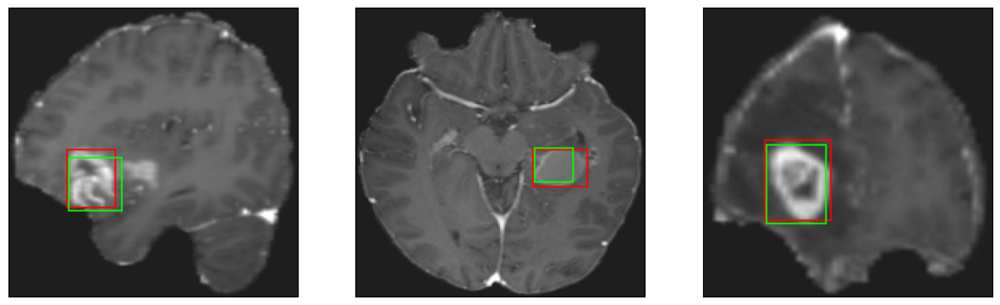

52/52 [==============================] - 8s 145ms/step - loss: 3.6698 - IoU: 0.6726 - val_loss: 4.8224 - val_IoU: 0.6198
Epoch 44/150
52/52 [==============================] - ETA: 0s - loss: 3.7911 - IoU: 0.6748
Epoch 44: val_loss did not improve from 4.39876
8/8 [==============================] - 0s 32ms/step


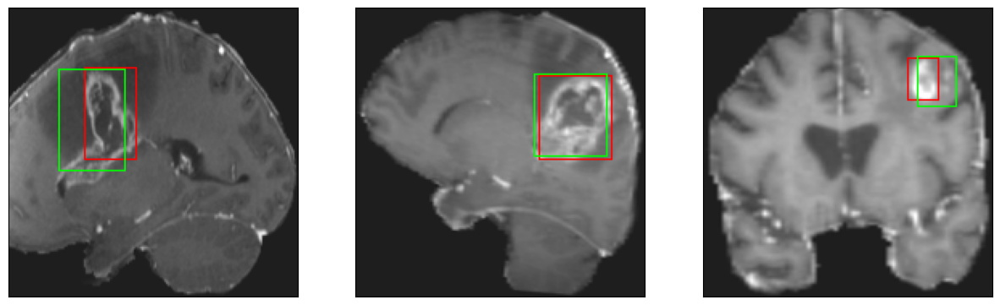

52/52 [==============================] - 7s 140ms/step - loss: 3.7911 - IoU: 0.6748 - val_loss: 4.6575 - val_IoU: 0.6450
Epoch 45/150
52/52 [==============================] - ETA: 0s - loss: 3.7711 - IoU: 0.6742
Epoch 45: val_loss did not improve from 4.39876
8/8 [==============================] - 0s 31ms/step


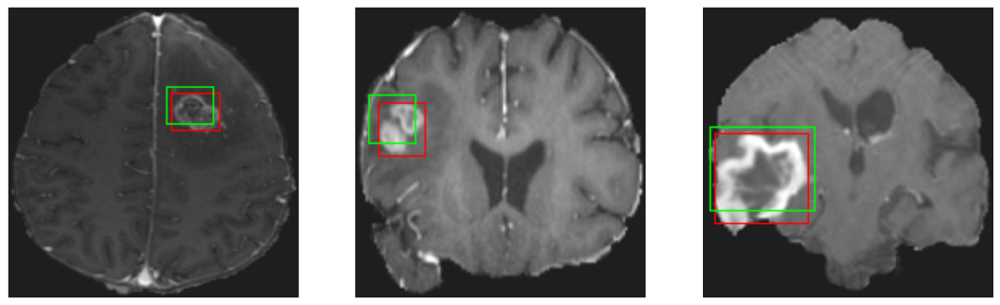

52/52 [==============================] - 7s 137ms/step - loss: 3.7711 - IoU: 0.6742 - val_loss: 6.5575 - val_IoU: 0.5216
Epoch 46/150
52/52 [==============================] - ETA: 0s - loss: 3.6954 - IoU: 0.6787
Epoch 46: val_loss improved from 4.39876 to 4.35944, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


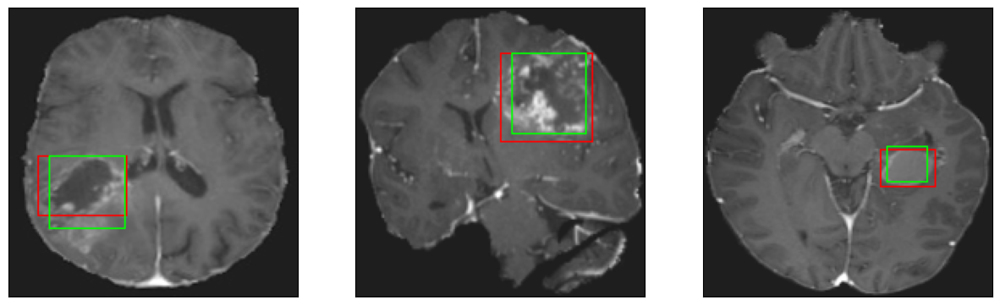

52/52 [==============================] - 10s 196ms/step - loss: 3.6954 - IoU: 0.6787 - val_loss: 4.3594 - val_IoU: 0.6762
Epoch 47/150
52/52 [==============================] - ETA: 0s - loss: 3.4900 - IoU: 0.6910
Epoch 47: val_loss did not improve from 4.35944
8/8 [==============================] - 0s 30ms/step


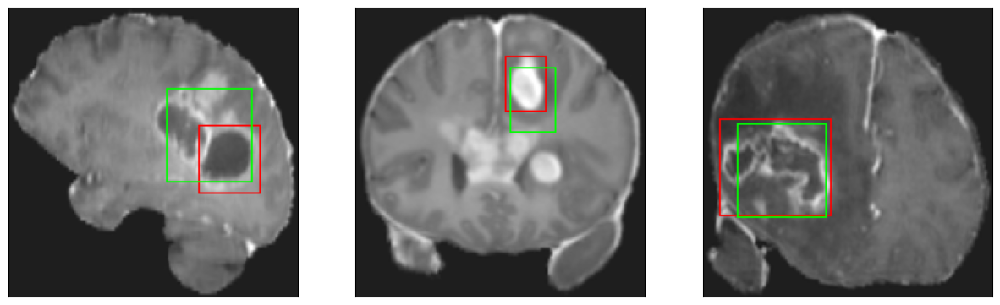

52/52 [==============================] - 7s 135ms/step - loss: 3.4900 - IoU: 0.6910 - val_loss: 4.6215 - val_IoU: 0.6423
Epoch 48/150
52/52 [==============================] - ETA: 0s - loss: 3.3824 - IoU: 0.6954
Epoch 48: val_loss did not improve from 4.35944
8/8 [==============================] - 0s 31ms/step


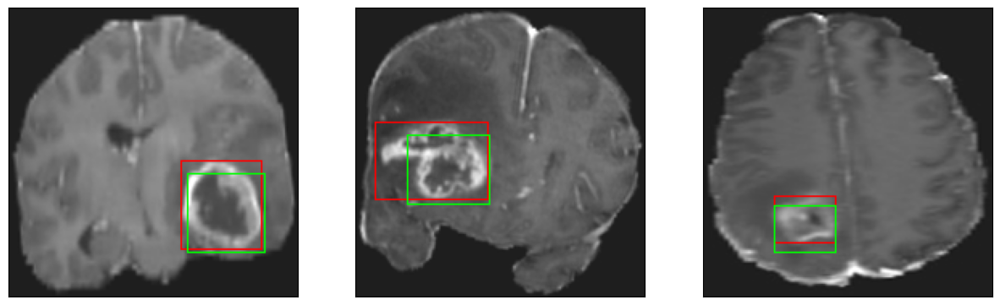

52/52 [==============================] - 7s 143ms/step - loss: 3.3824 - IoU: 0.6954 - val_loss: 5.1341 - val_IoU: 0.5797
Epoch 49/150
52/52 [==============================] - ETA: 0s - loss: 3.2892 - IoU: 0.7043
Epoch 49: val_loss did not improve from 4.35944
8/8 [==============================] - 0s 32ms/step


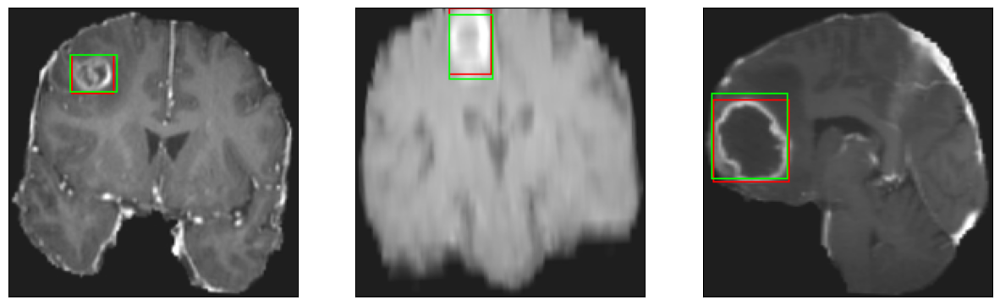

52/52 [==============================] - 7s 136ms/step - loss: 3.2892 - IoU: 0.7043 - val_loss: 4.3993 - val_IoU: 0.6864
Epoch 50/150
52/52 [==============================] - ETA: 0s - loss: 3.0908 - IoU: 0.7141
Epoch 50: val_loss did not improve from 4.35944
8/8 [==============================] - 0s 31ms/step


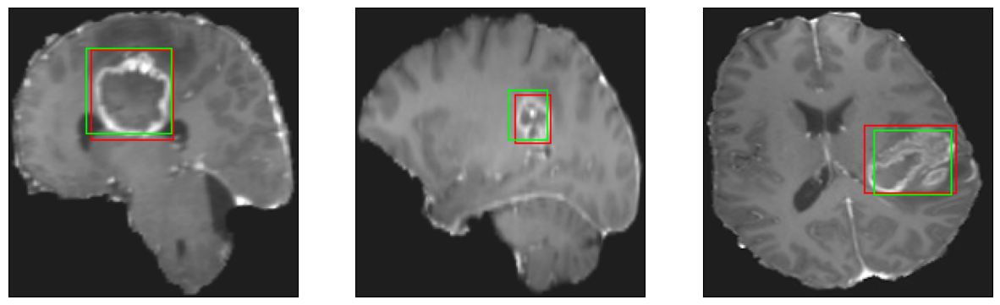

52/52 [==============================] - 7s 142ms/step - loss: 3.0908 - IoU: 0.7141 - val_loss: 4.4204 - val_IoU: 0.6775
Epoch 51/150
52/52 [==============================] - ETA: 0s - loss: 3.2475 - IoU: 0.7156
Epoch 51: val_loss did not improve from 4.35944
8/8 [==============================] - 0s 33ms/step


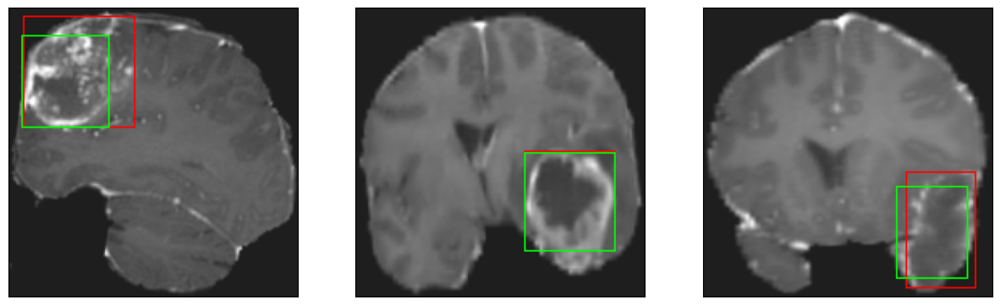

52/52 [==============================] - 7s 138ms/step - loss: 3.2475 - IoU: 0.7156 - val_loss: 4.7359 - val_IoU: 0.6615
Epoch 52/150
52/52 [==============================] - ETA: 0s - loss: 3.3721 - IoU: 0.6975
Epoch 52: val_loss improved from 4.35944 to 4.26613, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


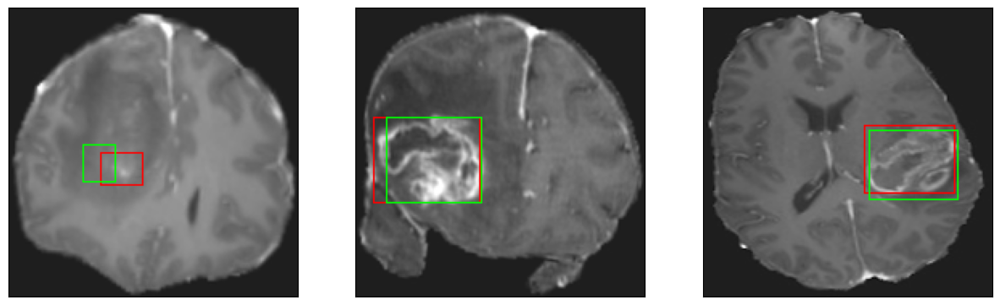

52/52 [==============================] - 11s 204ms/step - loss: 3.3721 - IoU: 0.6975 - val_loss: 4.2661 - val_IoU: 0.6755
Epoch 53/150
52/52 [==============================] - ETA: 0s - loss: 3.2585 - IoU: 0.7106
Epoch 53: val_loss did not improve from 4.26613
8/8 [==============================] - 0s 33ms/step


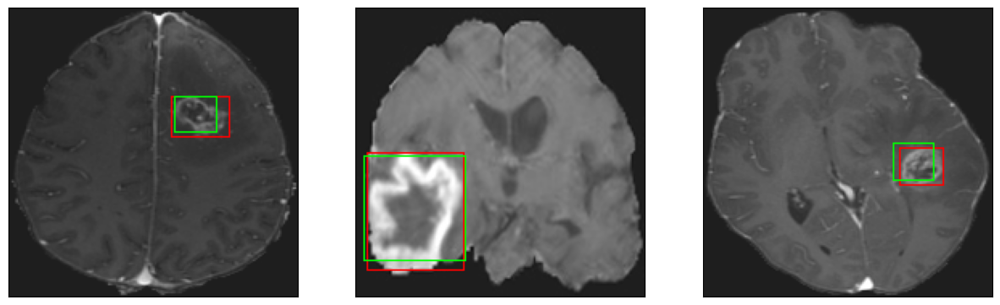

52/52 [==============================] - 7s 144ms/step - loss: 3.2585 - IoU: 0.7106 - val_loss: 4.3552 - val_IoU: 0.6537
Epoch 54/150
52/52 [==============================] - ETA: 0s - loss: 3.2727 - IoU: 0.7077
Epoch 54: val_loss did not improve from 4.26613
8/8 [==============================] - 0s 32ms/step


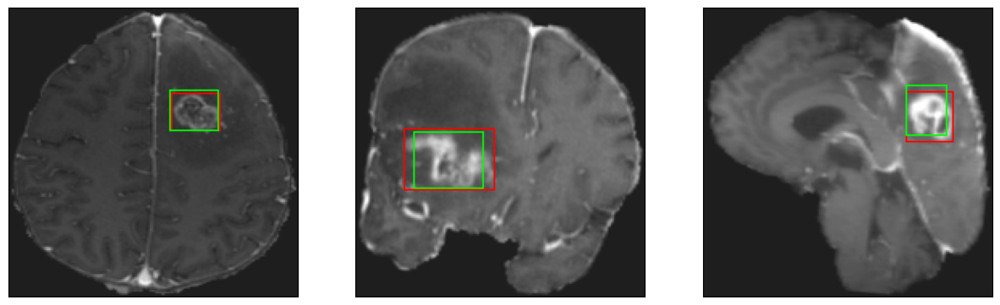

52/52 [==============================] - 7s 129ms/step - loss: 3.2727 - IoU: 0.7077 - val_loss: 4.6398 - val_IoU: 0.6653
Epoch 55/150
52/52 [==============================] - ETA: 0s - loss: 3.2952 - IoU: 0.7071
Epoch 55: val_loss did not improve from 4.26613
8/8 [==============================] - 0s 32ms/step


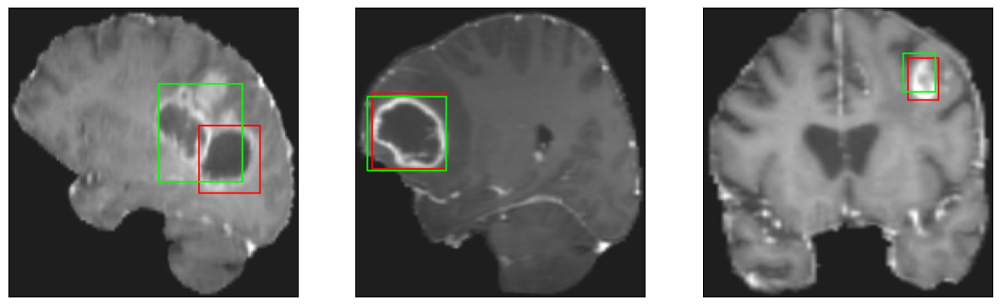

52/52 [==============================] - 8s 156ms/step - loss: 3.2952 - IoU: 0.7071 - val_loss: 4.8523 - val_IoU: 0.5928
Epoch 56/150
52/52 [==============================] - ETA: 0s - loss: 3.1844 - IoU: 0.7187
Epoch 56: val_loss did not improve from 4.26613
8/8 [==============================] - 0s 32ms/step


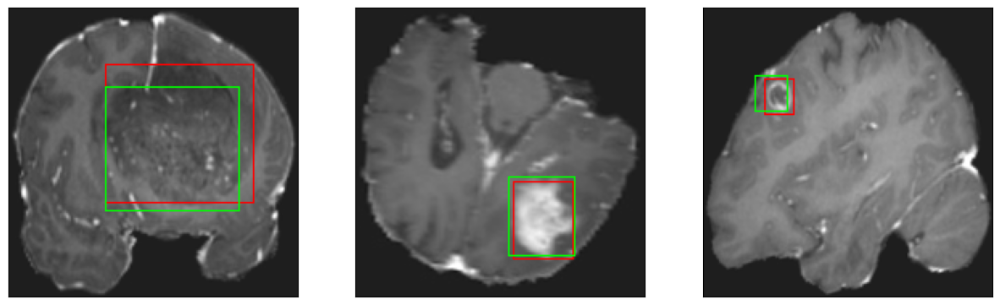

52/52 [==============================] - 7s 128ms/step - loss: 3.1844 - IoU: 0.7187 - val_loss: 4.9060 - val_IoU: 0.6621
Epoch 57/150
52/52 [==============================] - ETA: 0s - loss: 3.1241 - IoU: 0.7261
Epoch 57: val_loss did not improve from 4.26613
8/8 [==============================] - 0s 32ms/step


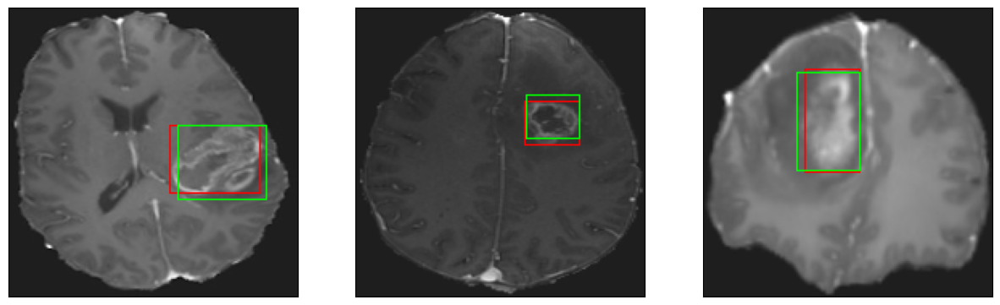

52/52 [==============================] - 8s 150ms/step - loss: 3.1241 - IoU: 0.7261 - val_loss: 4.3755 - val_IoU: 0.6915
Epoch 58/150
52/52 [==============================] - ETA: 0s - loss: 3.0848 - IoU: 0.7241
Epoch 58: val_loss did not improve from 4.26613
8/8 [==============================] - 0s 31ms/step


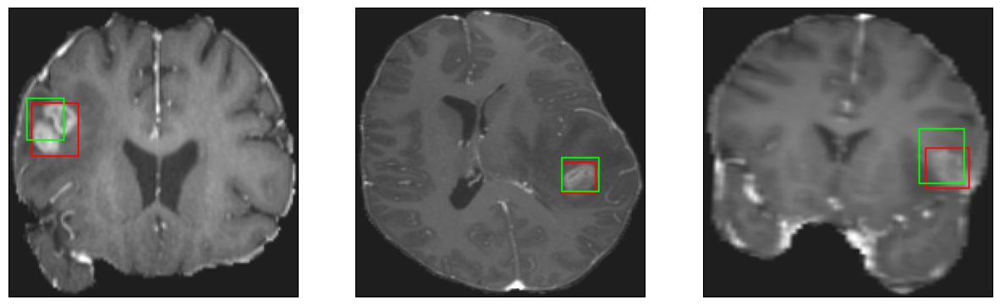

52/52 [==============================] - 7s 128ms/step - loss: 3.0848 - IoU: 0.7241 - val_loss: 4.3109 - val_IoU: 0.6840
Epoch 59/150
52/52 [==============================] - ETA: 0s - loss: 2.9429 - IoU: 0.7386
Epoch 59: val_loss improved from 4.26613 to 4.19270, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


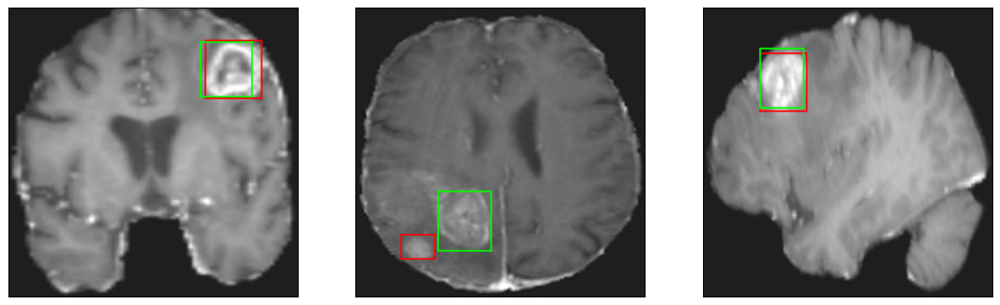

52/52 [==============================] - 10s 191ms/step - loss: 2.9429 - IoU: 0.7386 - val_loss: 4.1927 - val_IoU: 0.6989
Epoch 60/150
52/52 [==============================] - ETA: 0s - loss: 3.0902 - IoU: 0.7245
Epoch 60: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


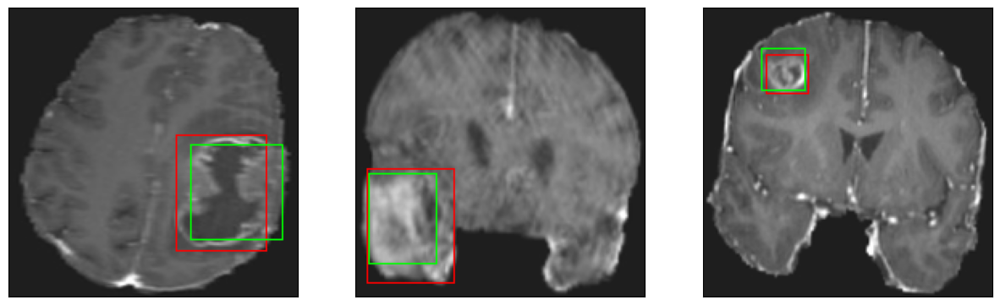

52/52 [==============================] - 7s 130ms/step - loss: 3.0902 - IoU: 0.7245 - val_loss: 4.4621 - val_IoU: 0.6798
Epoch 61/150
52/52 [==============================] - ETA: 0s - loss: 3.0368 - IoU: 0.7319
Epoch 61: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


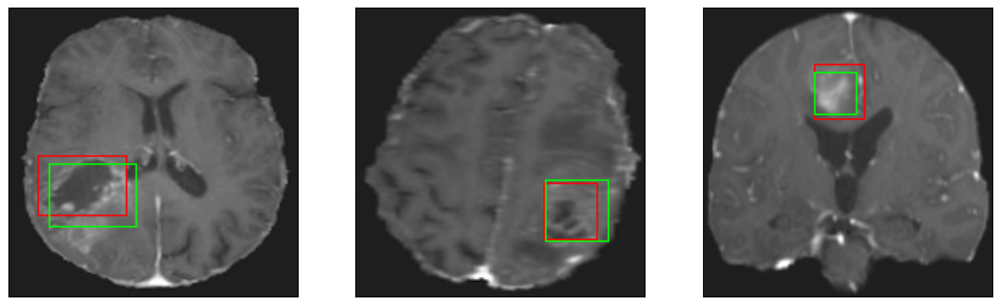

52/52 [==============================] - 7s 134ms/step - loss: 3.0368 - IoU: 0.7319 - val_loss: 4.9203 - val_IoU: 0.6455
Epoch 62/150
52/52 [==============================] - ETA: 0s - loss: 2.9627 - IoU: 0.7322
Epoch 62: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 36ms/step


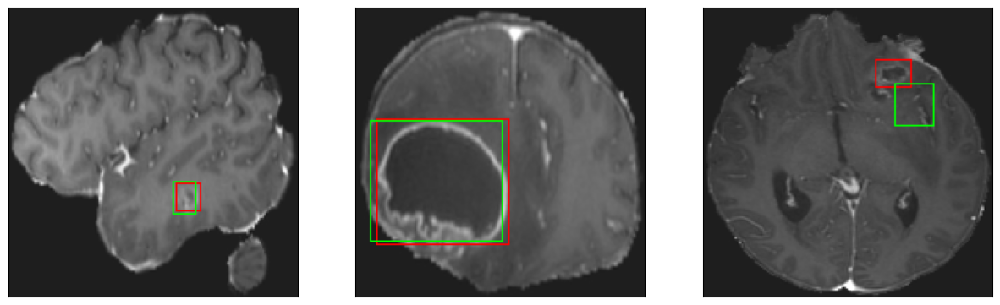

52/52 [==============================] - 8s 149ms/step - loss: 2.9627 - IoU: 0.7322 - val_loss: 4.3836 - val_IoU: 0.6758
Epoch 63/150
52/52 [==============================] - ETA: 0s - loss: 3.0389 - IoU: 0.7188
Epoch 63: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 32ms/step


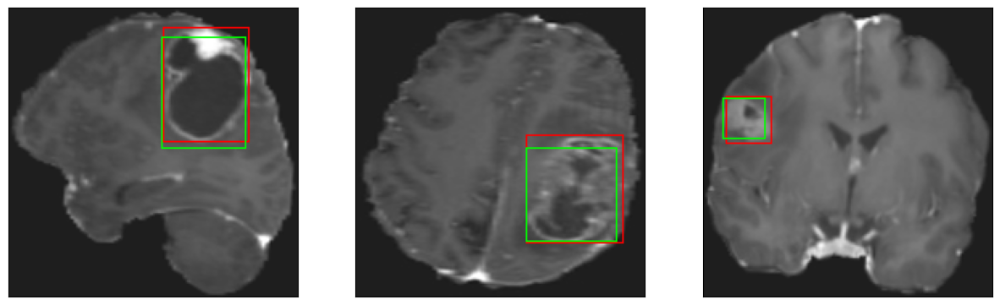

52/52 [==============================] - 7s 131ms/step - loss: 3.0389 - IoU: 0.7188 - val_loss: 4.3676 - val_IoU: 0.6430
Epoch 64/150
52/52 [==============================] - ETA: 0s - loss: 2.7581 - IoU: 0.7414
Epoch 64: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 32ms/step


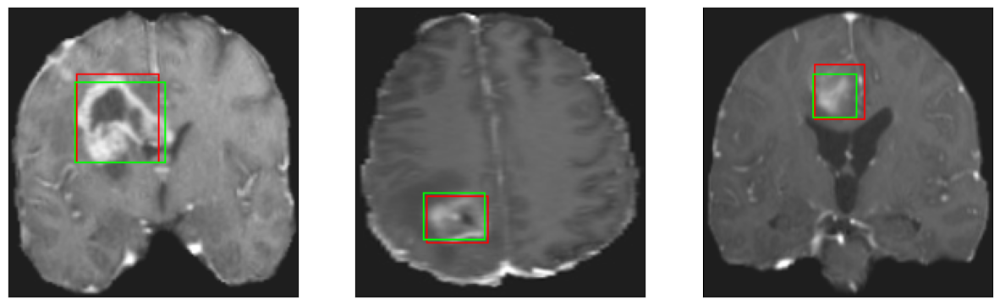

52/52 [==============================] - 7s 141ms/step - loss: 2.7581 - IoU: 0.7414 - val_loss: 4.4986 - val_IoU: 0.6587
Epoch 65/150
52/52 [==============================] - ETA: 0s - loss: 2.8467 - IoU: 0.7348
Epoch 65: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 32ms/step


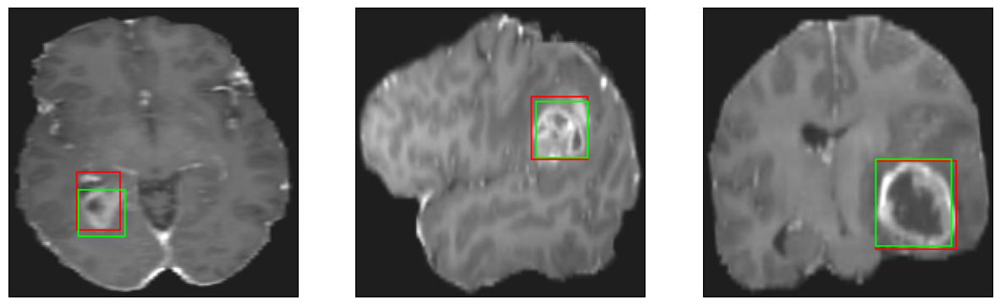

52/52 [==============================] - 7s 132ms/step - loss: 2.8467 - IoU: 0.7348 - val_loss: 4.2870 - val_IoU: 0.6858
Epoch 66/150
52/52 [==============================] - ETA: 0s - loss: 2.8375 - IoU: 0.7375
Epoch 66: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 36ms/step


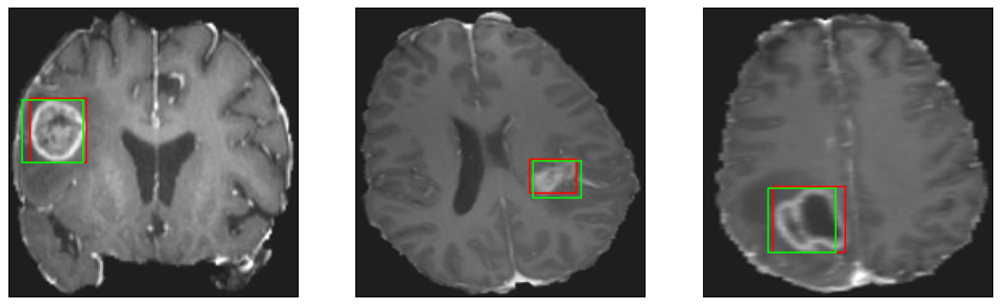

52/52 [==============================] - 7s 140ms/step - loss: 2.8375 - IoU: 0.7375 - val_loss: 4.3792 - val_IoU: 0.6749
Epoch 67/150
52/52 [==============================] - ETA: 0s - loss: 2.8081 - IoU: 0.7414
Epoch 67: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


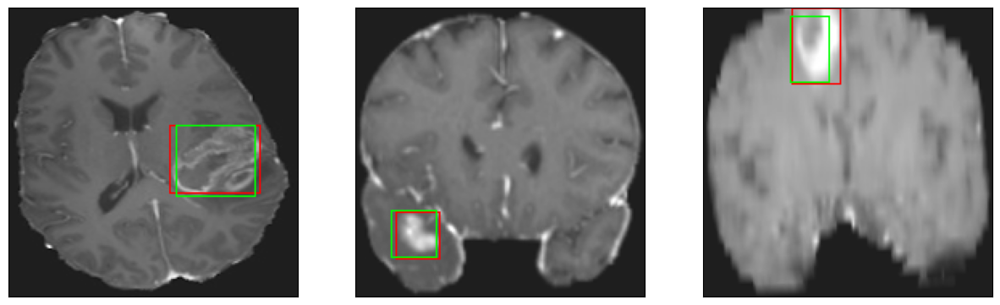

52/52 [==============================] - 7s 135ms/step - loss: 2.8081 - IoU: 0.7414 - val_loss: 4.7378 - val_IoU: 0.6379
Epoch 68/150
52/52 [==============================] - ETA: 0s - loss: 2.8121 - IoU: 0.7471
Epoch 68: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 33ms/step


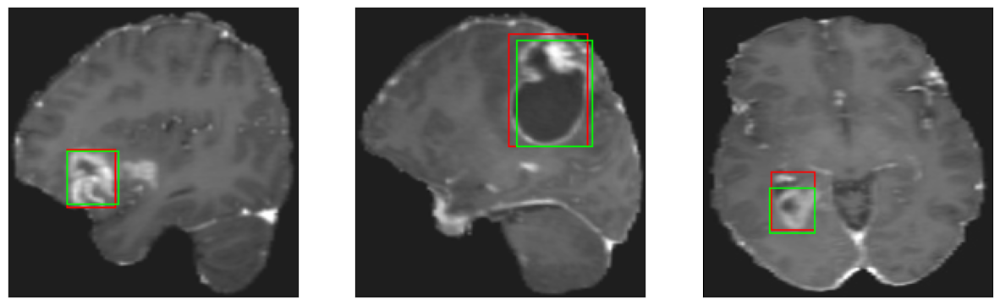

52/52 [==============================] - 7s 133ms/step - loss: 2.8121 - IoU: 0.7471 - val_loss: 4.5092 - val_IoU: 0.6769
Epoch 69/150
52/52 [==============================] - ETA: 0s - loss: 2.8614 - IoU: 0.7455
Epoch 69: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


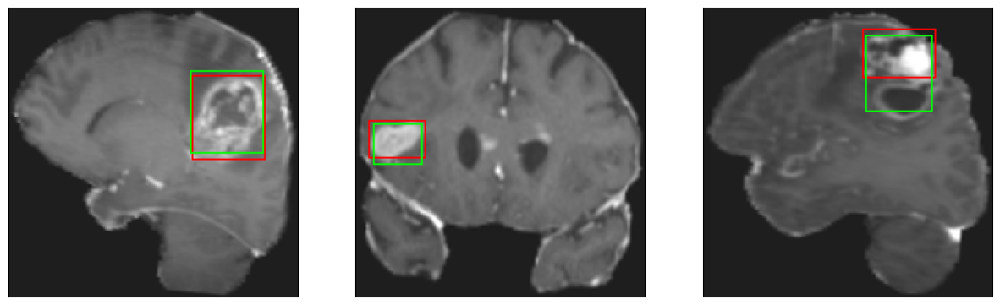

52/52 [==============================] - 7s 141ms/step - loss: 2.8614 - IoU: 0.7455 - val_loss: 4.4617 - val_IoU: 0.6757
Epoch 70/150
52/52 [==============================] - ETA: 0s - loss: 2.9265 - IoU: 0.7311
Epoch 70: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 34ms/step


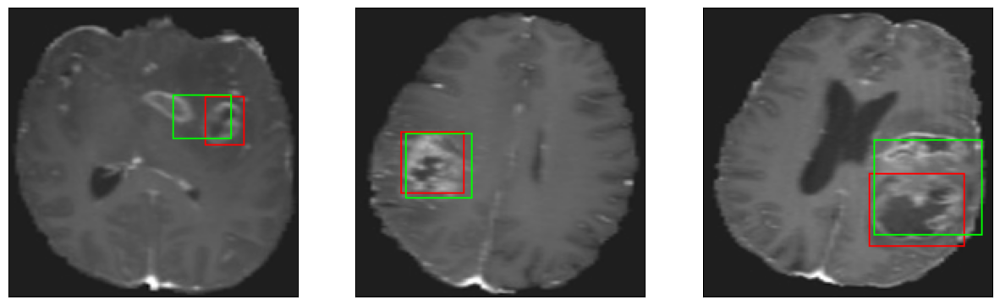

52/52 [==============================] - 7s 141ms/step - loss: 2.9265 - IoU: 0.7311 - val_loss: 4.3753 - val_IoU: 0.6797
Epoch 71/150
52/52 [==============================] - ETA: 0s - loss: 2.8302 - IoU: 0.7401
Epoch 71: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


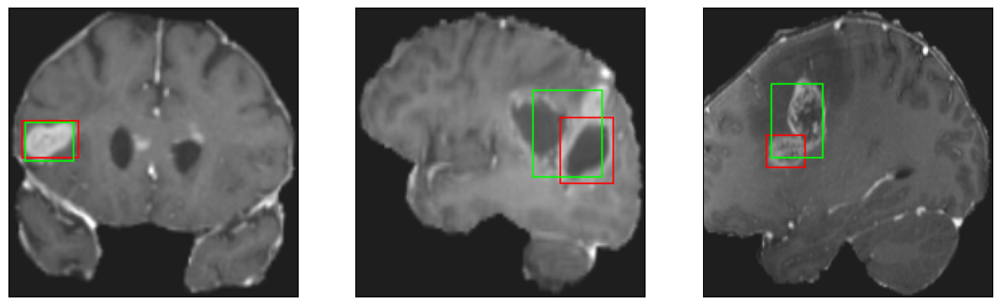

52/52 [==============================] - 7s 132ms/step - loss: 2.8302 - IoU: 0.7401 - val_loss: 4.2098 - val_IoU: 0.6814
Epoch 72/150
52/52 [==============================] - ETA: 0s - loss: 2.7153 - IoU: 0.7500
Epoch 72: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


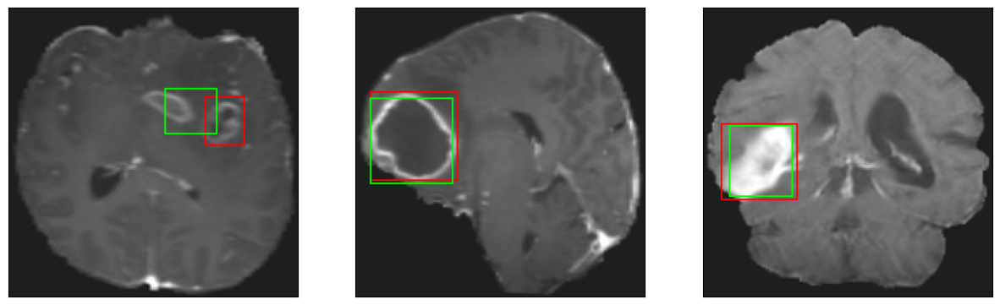

52/52 [==============================] - 7s 139ms/step - loss: 2.7153 - IoU: 0.7500 - val_loss: 4.2493 - val_IoU: 0.6768
Epoch 73/150
52/52 [==============================] - ETA: 0s - loss: 2.7291 - IoU: 0.7475
Epoch 73: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 31ms/step


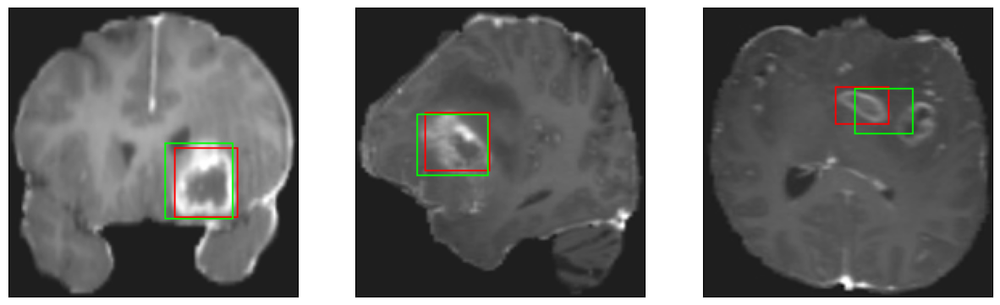

52/52 [==============================] - 7s 132ms/step - loss: 2.7291 - IoU: 0.7475 - val_loss: 4.7345 - val_IoU: 0.6349
Epoch 74/150
52/52 [==============================] - ETA: 0s - loss: 2.6211 - IoU: 0.7607
Epoch 74: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 32ms/step


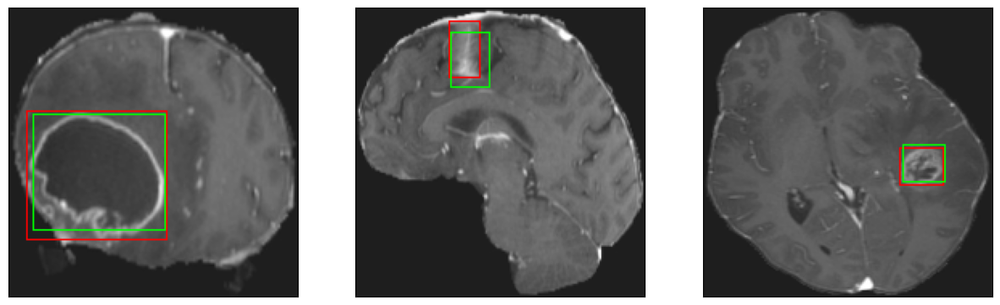

52/52 [==============================] - 7s 131ms/step - loss: 2.6211 - IoU: 0.7607 - val_loss: 4.2885 - val_IoU: 0.6873
Epoch 75/150
52/52 [==============================] - ETA: 0s - loss: 2.8021 - IoU: 0.7430
Epoch 75: val_loss did not improve from 4.19270
8/8 [==============================] - 0s 33ms/step


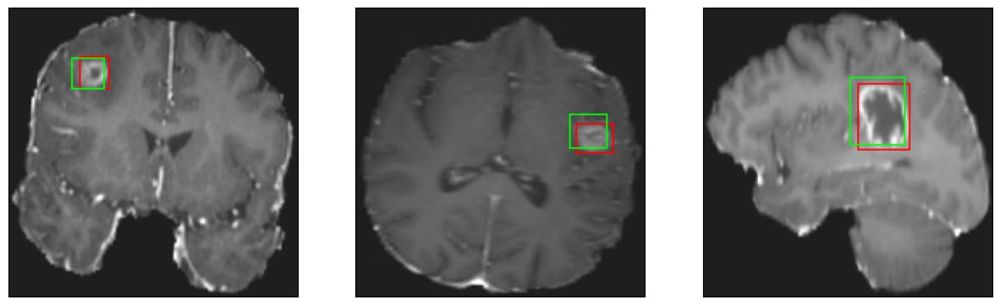

52/52 [==============================] - 7s 135ms/step - loss: 2.8021 - IoU: 0.7430 - val_loss: 4.4218 - val_IoU: 0.6584
Epoch 76/150
52/52 [==============================] - ETA: 0s - loss: 2.6982 - IoU: 0.7517
Epoch 76: val_loss improved from 4.19270 to 4.15453, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


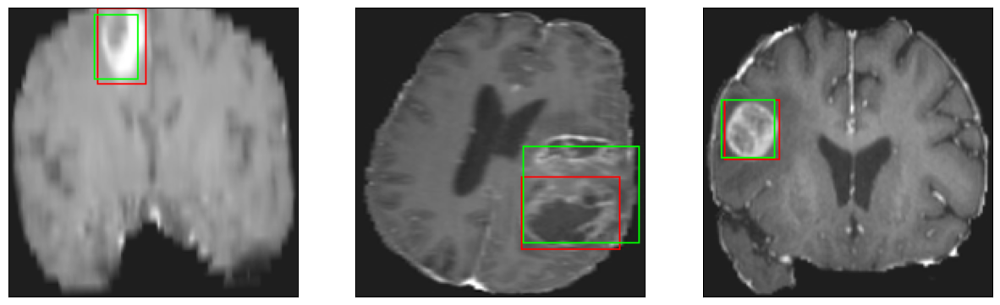

52/52 [==============================] - 10s 189ms/step - loss: 2.6982 - IoU: 0.7517 - val_loss: 4.1545 - val_IoU: 0.7091
Epoch 77/150
52/52 [==============================] - ETA: 0s - loss: 2.5708 - IoU: 0.7617
Epoch 77: val_loss did not improve from 4.15453
8/8 [==============================] - 0s 35ms/step


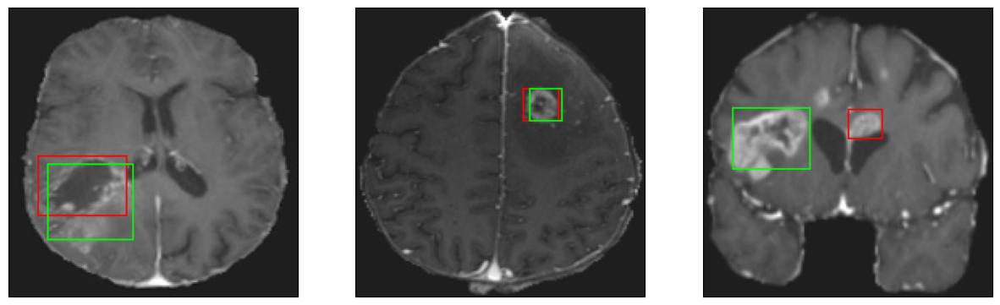

52/52 [==============================] - 7s 135ms/step - loss: 2.5708 - IoU: 0.7617 - val_loss: 4.4362 - val_IoU: 0.6682
Epoch 78/150
52/52 [==============================] - ETA: 0s - loss: 2.6779 - IoU: 0.7478
Epoch 78: val_loss did not improve from 4.15453
8/8 [==============================] - 0s 34ms/step


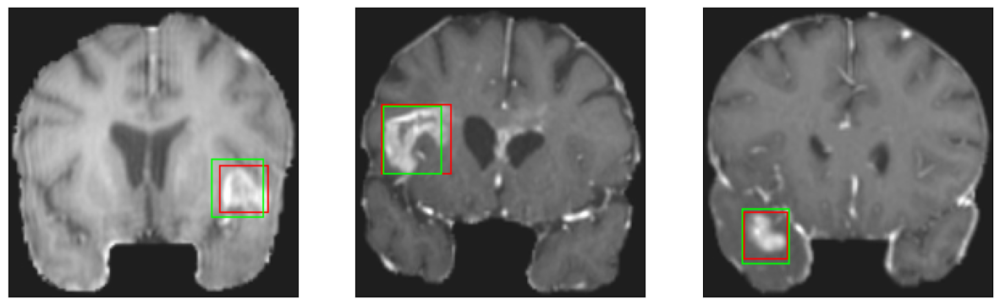

52/52 [==============================] - 8s 149ms/step - loss: 2.6779 - IoU: 0.7478 - val_loss: 4.7719 - val_IoU: 0.6480
Epoch 79/150
52/52 [==============================] - ETA: 0s - loss: 2.6550 - IoU: 0.7655
Epoch 79: val_loss improved from 4.15453 to 4.12100, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


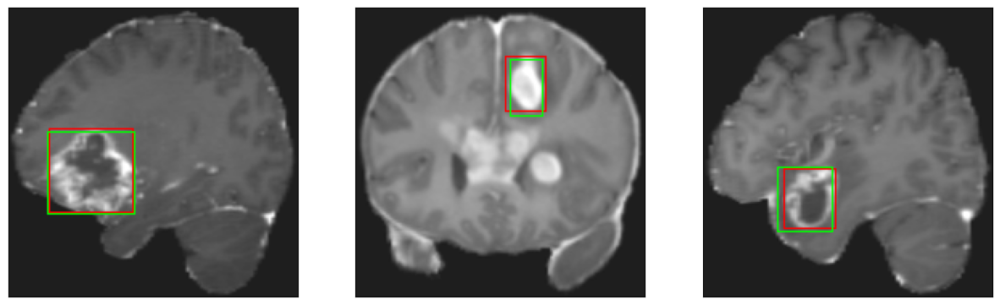

52/52 [==============================] - 10s 184ms/step - loss: 2.6550 - IoU: 0.7655 - val_loss: 4.1210 - val_IoU: 0.6955
Epoch 80/150
52/52 [==============================] - ETA: 0s - loss: 2.5464 - IoU: 0.7649
Epoch 80: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 31ms/step


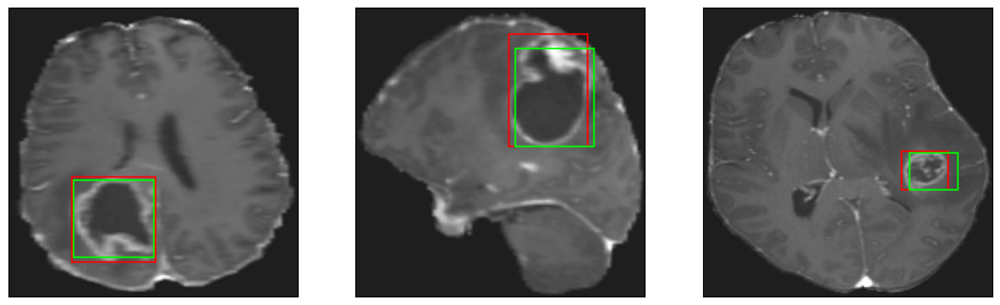

52/52 [==============================] - 8s 146ms/step - loss: 2.5464 - IoU: 0.7649 - val_loss: 4.5454 - val_IoU: 0.6724
Epoch 81/150
52/52 [==============================] - ETA: 0s - loss: 2.6987 - IoU: 0.7584
Epoch 81: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 31ms/step


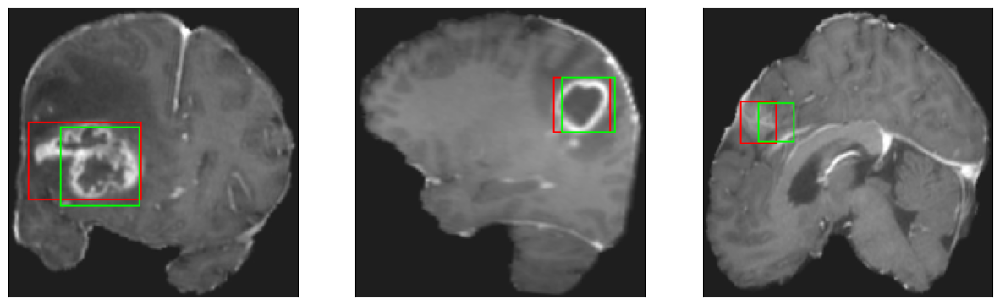

52/52 [==============================] - 7s 132ms/step - loss: 2.6987 - IoU: 0.7584 - val_loss: 4.3443 - val_IoU: 0.6758
Epoch 82/150
52/52 [==============================] - ETA: 0s - loss: 2.7000 - IoU: 0.7539
Epoch 82: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 34ms/step


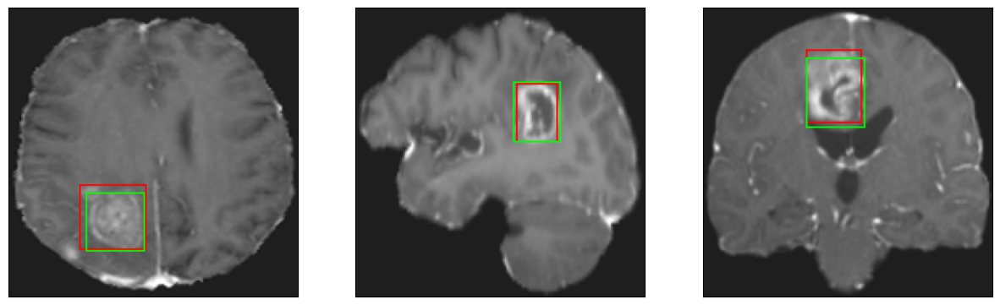

52/52 [==============================] - 7s 139ms/step - loss: 2.7000 - IoU: 0.7539 - val_loss: 4.2131 - val_IoU: 0.7008
Epoch 83/150
52/52 [==============================] - ETA: 0s - loss: 2.5509 - IoU: 0.7605
Epoch 83: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 31ms/step


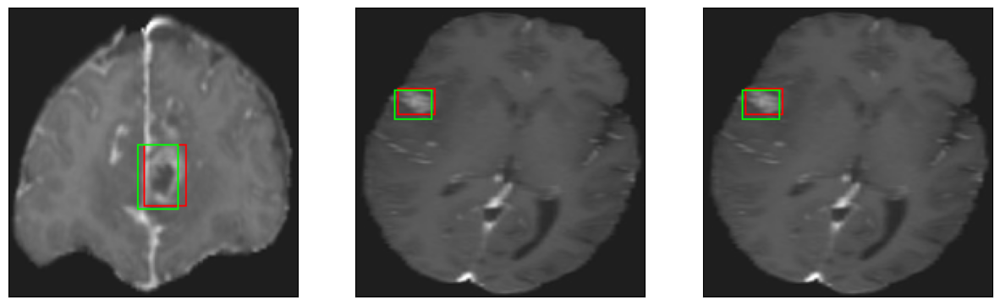

52/52 [==============================] - 7s 137ms/step - loss: 2.5509 - IoU: 0.7605 - val_loss: 4.4568 - val_IoU: 0.6766
Epoch 84/150
52/52 [==============================] - ETA: 0s - loss: 2.5699 - IoU: 0.7657
Epoch 84: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


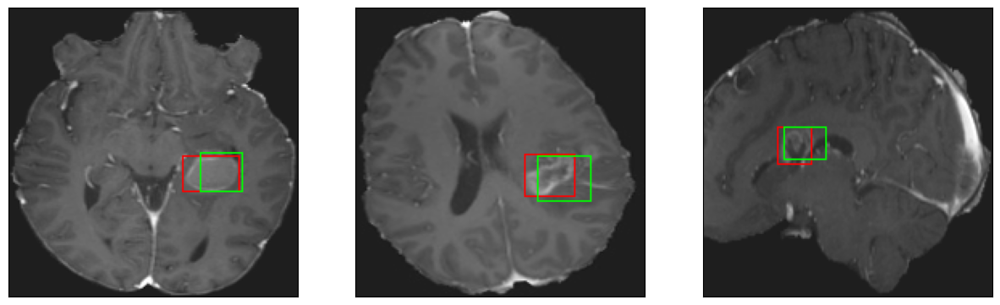

52/52 [==============================] - 8s 160ms/step - loss: 2.5699 - IoU: 0.7657 - val_loss: 4.7729 - val_IoU: 0.6376
Epoch 85/150
52/52 [==============================] - ETA: 0s - loss: 2.6256 - IoU: 0.7522
Epoch 85: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 31ms/step


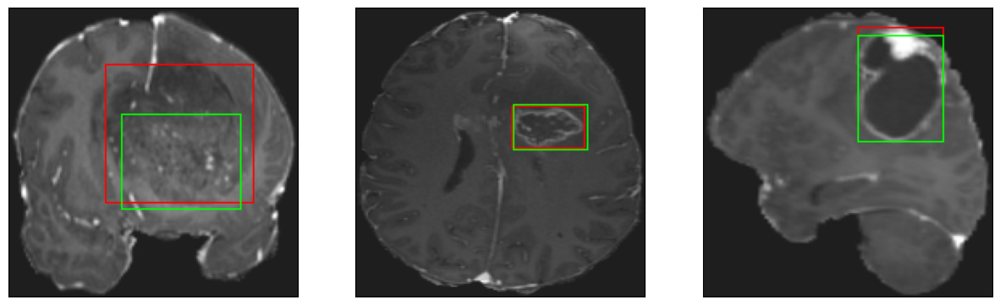

52/52 [==============================] - 7s 131ms/step - loss: 2.6256 - IoU: 0.7522 - val_loss: 4.3906 - val_IoU: 0.6987
Epoch 86/150
52/52 [==============================] - ETA: 0s - loss: 2.5443 - IoU: 0.7638
Epoch 86: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


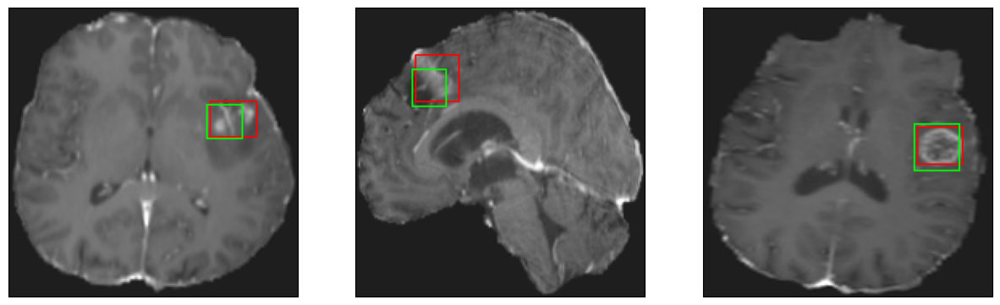

52/52 [==============================] - 7s 134ms/step - loss: 2.5443 - IoU: 0.7638 - val_loss: 4.2426 - val_IoU: 0.6949
Epoch 87/150
52/52 [==============================] - ETA: 0s - loss: 2.5088 - IoU: 0.7707
Epoch 87: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 33ms/step


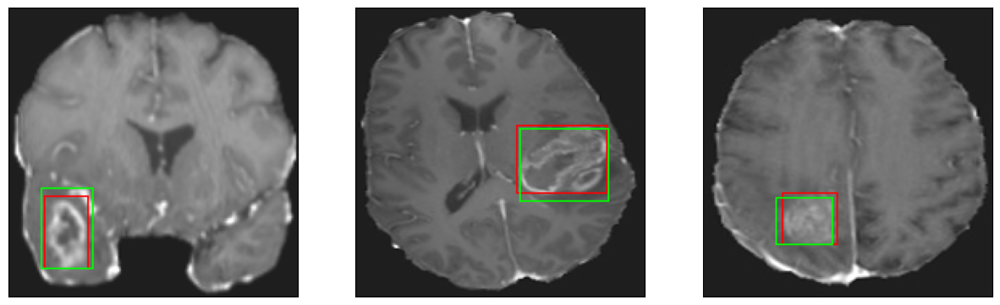

52/52 [==============================] - 7s 138ms/step - loss: 2.5088 - IoU: 0.7707 - val_loss: 4.3912 - val_IoU: 0.7018
Epoch 88/150
52/52 [==============================] - ETA: 0s - loss: 2.3811 - IoU: 0.7814
Epoch 88: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


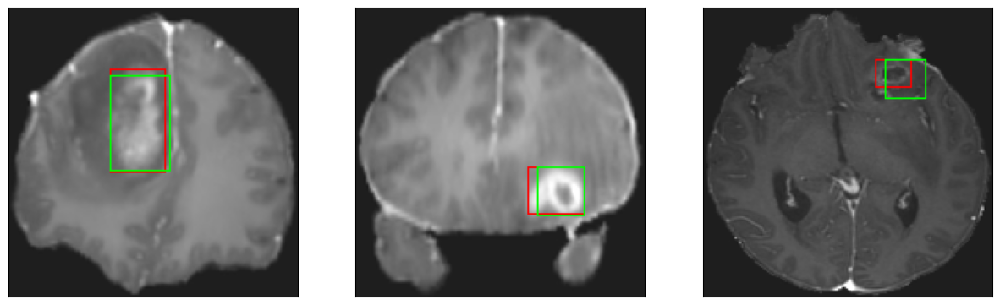

52/52 [==============================] - 7s 130ms/step - loss: 2.3811 - IoU: 0.7814 - val_loss: 4.2000 - val_IoU: 0.7036
Epoch 89/150
52/52 [==============================] - ETA: 0s - loss: 2.5199 - IoU: 0.7712
Epoch 89: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 33ms/step


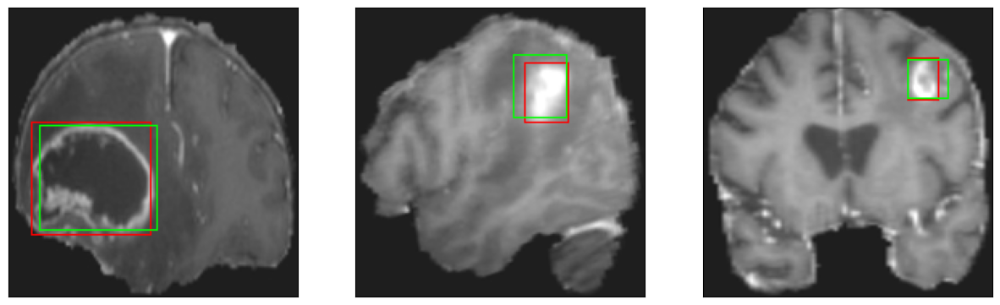

52/52 [==============================] - 8s 153ms/step - loss: 2.5199 - IoU: 0.7712 - val_loss: 4.4525 - val_IoU: 0.6913
Epoch 90/150
52/52 [==============================] - ETA: 0s - loss: 2.4156 - IoU: 0.7809
Epoch 90: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 31ms/step


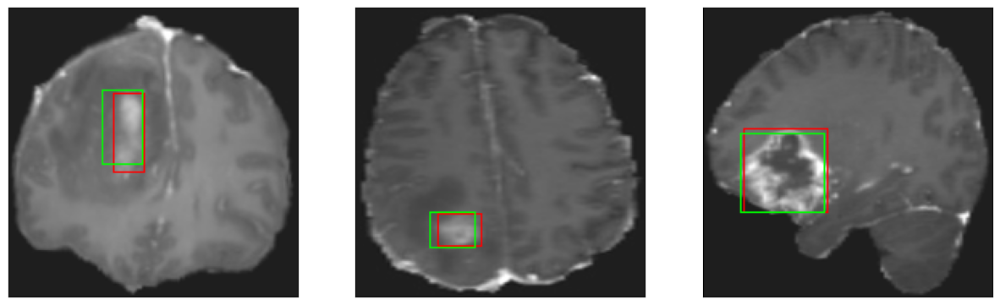

52/52 [==============================] - 7s 129ms/step - loss: 2.4156 - IoU: 0.7809 - val_loss: 4.2188 - val_IoU: 0.6969
Epoch 91/150
52/52 [==============================] - ETA: 0s - loss: 2.3600 - IoU: 0.7861
Epoch 91: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


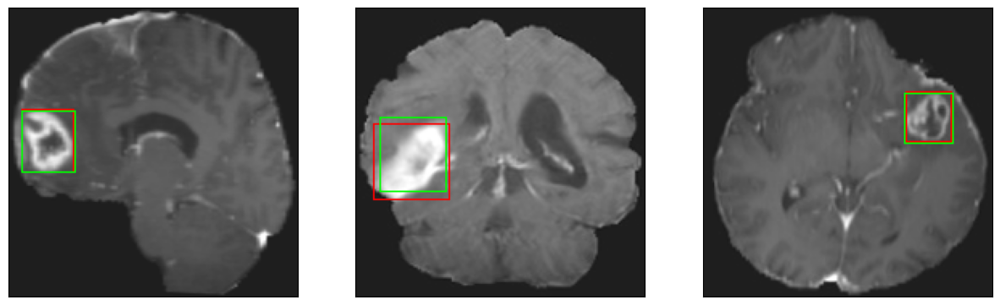

52/52 [==============================] - 8s 148ms/step - loss: 2.3600 - IoU: 0.7861 - val_loss: 4.2270 - val_IoU: 0.7064
Epoch 92/150
52/52 [==============================] - ETA: 0s - loss: 2.4621 - IoU: 0.7656
Epoch 92: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


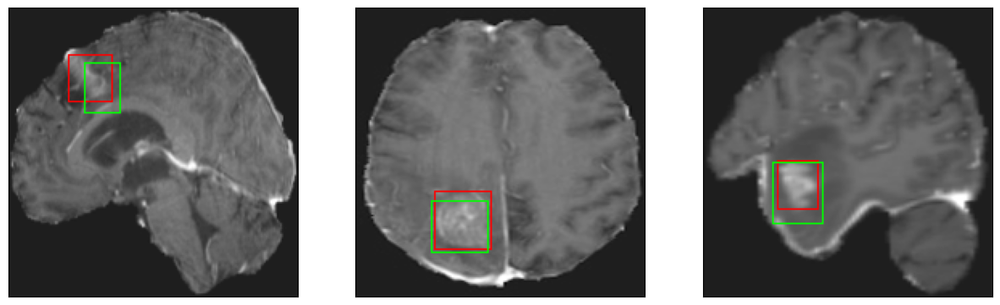

52/52 [==============================] - 7s 129ms/step - loss: 2.4621 - IoU: 0.7656 - val_loss: 4.3137 - val_IoU: 0.6869
Epoch 93/150
52/52 [==============================] - ETA: 0s - loss: 2.5711 - IoU: 0.7612
Epoch 93: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 33ms/step


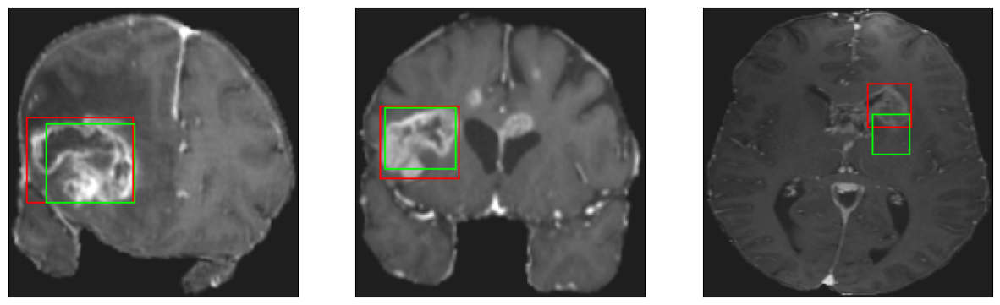

52/52 [==============================] - 7s 135ms/step - loss: 2.5711 - IoU: 0.7612 - val_loss: 4.1638 - val_IoU: 0.6975
Epoch 94/150
52/52 [==============================] - ETA: 0s - loss: 2.4599 - IoU: 0.7787
Epoch 94: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


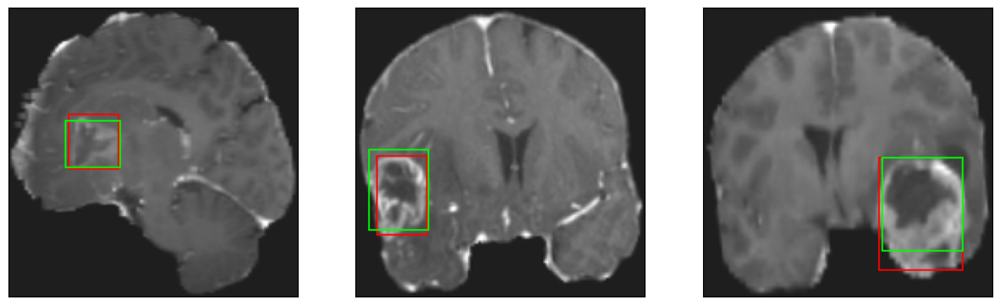

52/52 [==============================] - 7s 137ms/step - loss: 2.4599 - IoU: 0.7787 - val_loss: 4.1462 - val_IoU: 0.6879
Epoch 95/150
52/52 [==============================] - ETA: 0s - loss: 2.4554 - IoU: 0.7781
Epoch 95: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 31ms/step


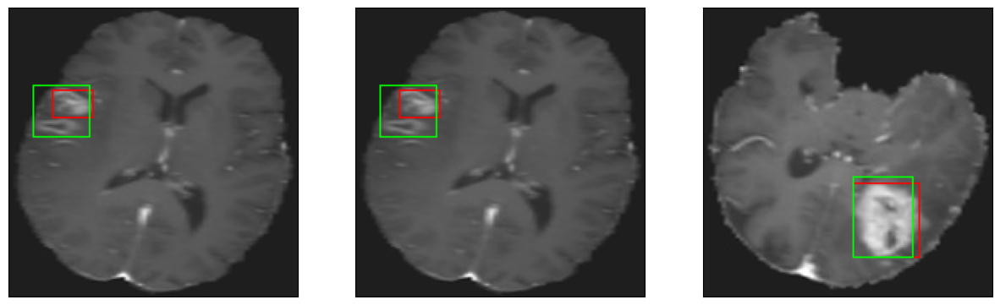

52/52 [==============================] - 7s 134ms/step - loss: 2.4554 - IoU: 0.7781 - val_loss: 4.1273 - val_IoU: 0.6907
Epoch 96/150
52/52 [==============================] - ETA: 0s - loss: 2.4730 - IoU: 0.7717
Epoch 96: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


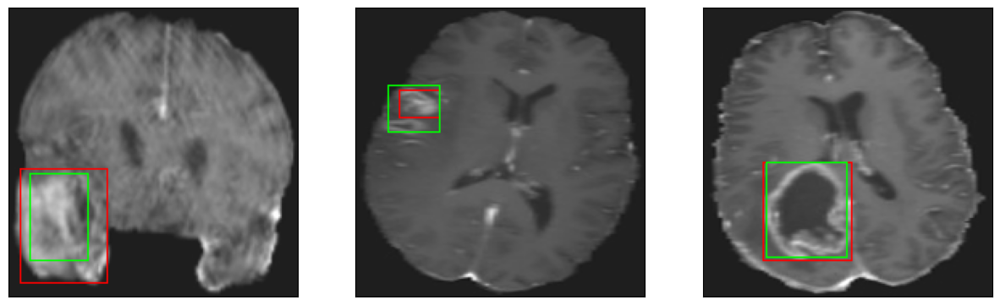

52/52 [==============================] - 7s 128ms/step - loss: 2.4730 - IoU: 0.7717 - val_loss: 4.1874 - val_IoU: 0.6986
Epoch 97/150
52/52 [==============================] - ETA: 0s - loss: 2.3496 - IoU: 0.7847
Epoch 97: val_loss did not improve from 4.12100
8/8 [==============================] - 0s 32ms/step


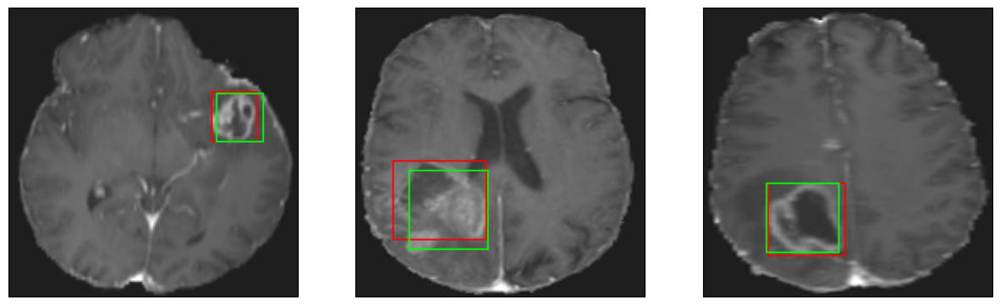

52/52 [==============================] - 7s 132ms/step - loss: 2.3496 - IoU: 0.7847 - val_loss: 4.2428 - val_IoU: 0.6813
Epoch 98/150
52/52 [==============================] - ETA: 0s - loss: 2.3859 - IoU: 0.7795
Epoch 98: val_loss improved from 4.12100 to 3.99449, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


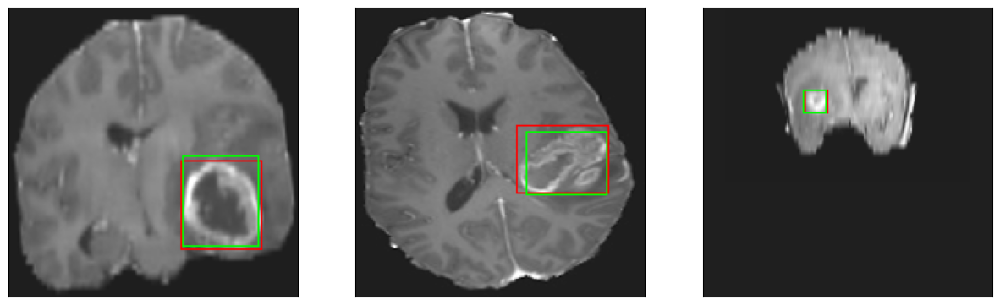

52/52 [==============================] - 10s 196ms/step - loss: 2.3859 - IoU: 0.7795 - val_loss: 3.9945 - val_IoU: 0.7080
Epoch 99/150
52/52 [==============================] - ETA: 0s - loss: 2.3158 - IoU: 0.7905
Epoch 99: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 32ms/step


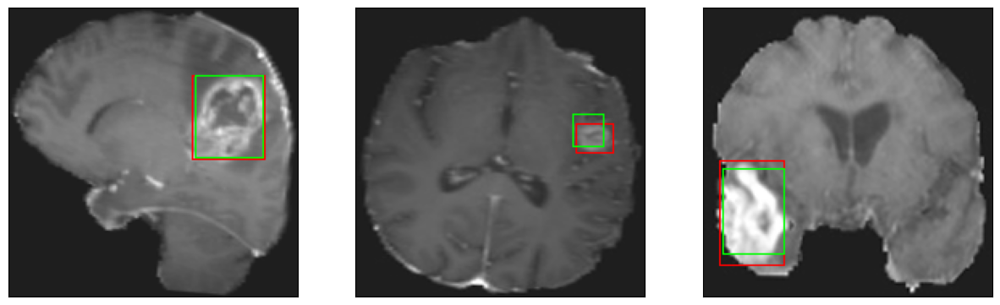

52/52 [==============================] - 7s 132ms/step - loss: 2.3158 - IoU: 0.7905 - val_loss: 4.2278 - val_IoU: 0.6820
Epoch 100/150
52/52 [==============================] - ETA: 0s - loss: 2.3276 - IoU: 0.7891
Epoch 100: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


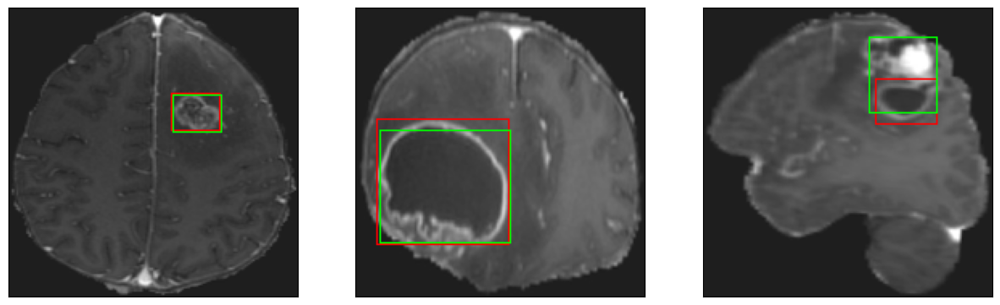

52/52 [==============================] - 8s 153ms/step - loss: 2.3276 - IoU: 0.7891 - val_loss: 4.0797 - val_IoU: 0.7021
Epoch 101/150
52/52 [==============================] - ETA: 0s - loss: 2.2497 - IoU: 0.7968
Epoch 101: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


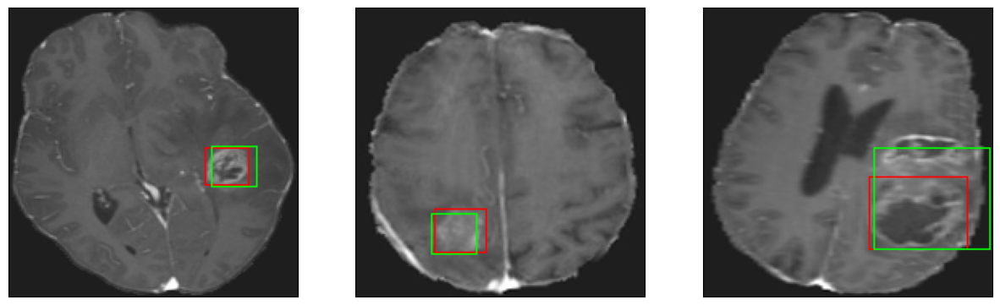

52/52 [==============================] - 7s 128ms/step - loss: 2.2497 - IoU: 0.7968 - val_loss: 4.0766 - val_IoU: 0.7161
Epoch 102/150
52/52 [==============================] - ETA: 0s - loss: 2.4016 - IoU: 0.7824
Epoch 102: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


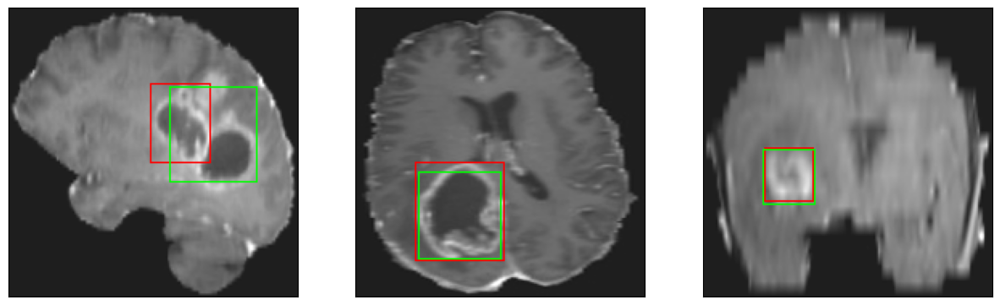

52/52 [==============================] - 7s 133ms/step - loss: 2.4016 - IoU: 0.7824 - val_loss: 4.0770 - val_IoU: 0.7019
Epoch 103/150
52/52 [==============================] - ETA: 0s - loss: 2.4039 - IoU: 0.7826
Epoch 103: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


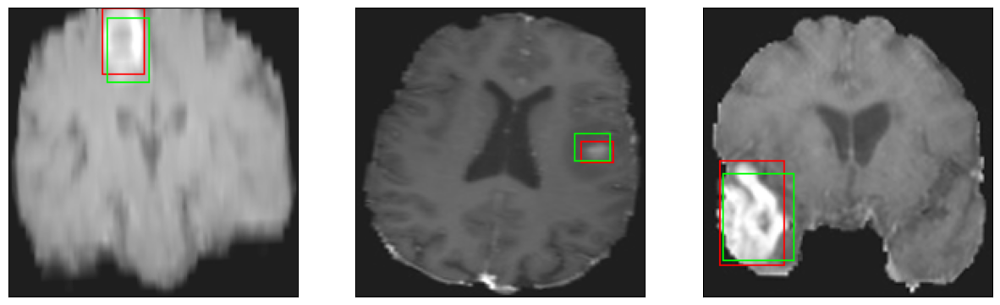

52/52 [==============================] - 8s 145ms/step - loss: 2.4039 - IoU: 0.7826 - val_loss: 4.2104 - val_IoU: 0.7046
Epoch 104/150
52/52 [==============================] - ETA: 0s - loss: 2.4033 - IoU: 0.7770
Epoch 104: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


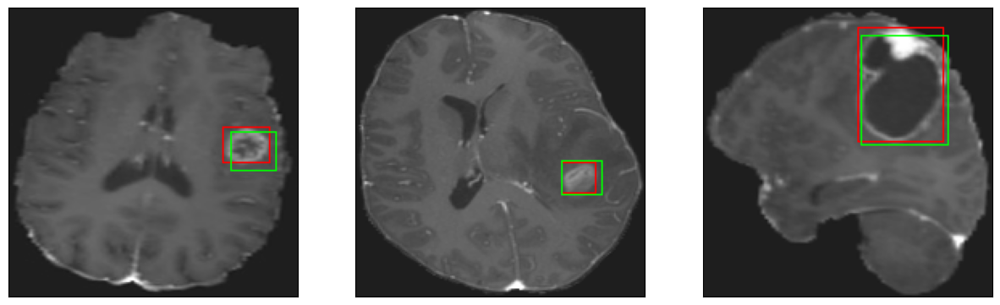

52/52 [==============================] - 7s 130ms/step - loss: 2.4033 - IoU: 0.7770 - val_loss: 4.1941 - val_IoU: 0.6875
Epoch 105/150
52/52 [==============================] - ETA: 0s - loss: 2.5405 - IoU: 0.7653
Epoch 105: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


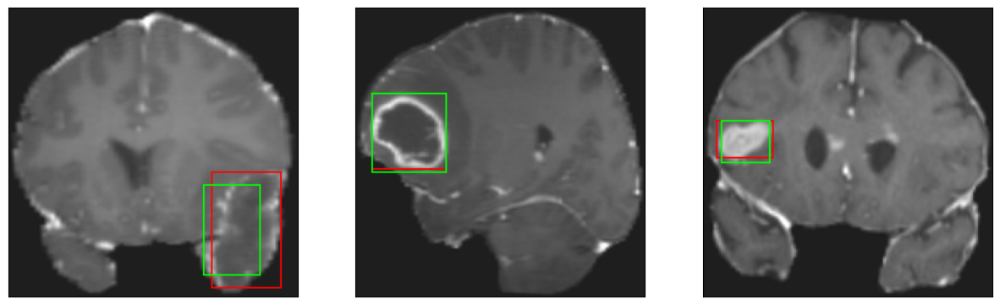

52/52 [==============================] - 7s 130ms/step - loss: 2.5405 - IoU: 0.7653 - val_loss: 4.0829 - val_IoU: 0.7103
Epoch 106/150
52/52 [==============================] - ETA: 0s - loss: 2.4820 - IoU: 0.7651
Epoch 106: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 32ms/step


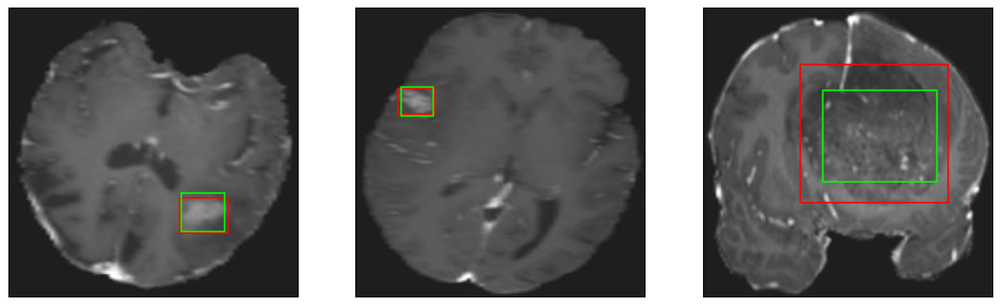

52/52 [==============================] - 8s 152ms/step - loss: 2.4820 - IoU: 0.7651 - val_loss: 4.3464 - val_IoU: 0.6880
Epoch 107/150
52/52 [==============================] - ETA: 0s - loss: 2.3662 - IoU: 0.7805
Epoch 107: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 34ms/step


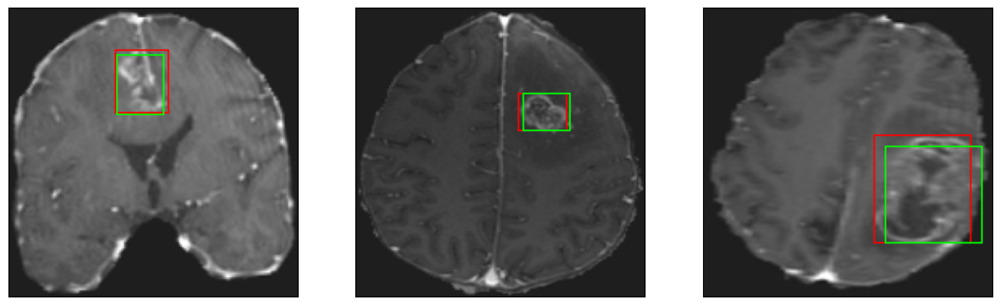

52/52 [==============================] - 7s 129ms/step - loss: 2.3662 - IoU: 0.7805 - val_loss: 4.2339 - val_IoU: 0.6874
Epoch 108/150
52/52 [==============================] - ETA: 0s - loss: 2.3156 - IoU: 0.7845
Epoch 108: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


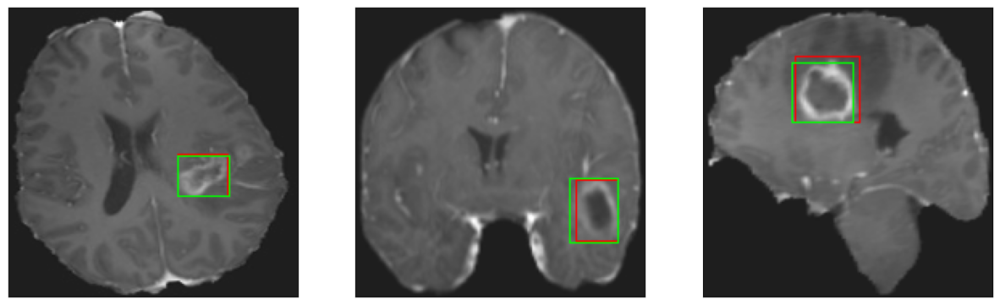

52/52 [==============================] - 7s 128ms/step - loss: 2.3156 - IoU: 0.7845 - val_loss: 4.2822 - val_IoU: 0.6960
Epoch 109/150
52/52 [==============================] - ETA: 0s - loss: 2.2427 - IoU: 0.7908
Epoch 109: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 33ms/step


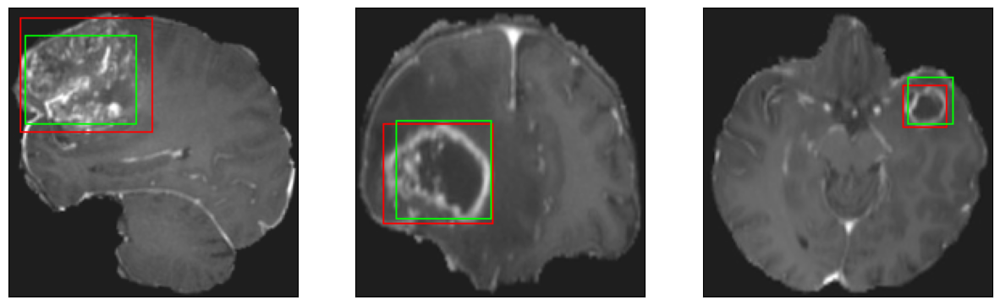

52/52 [==============================] - 7s 143ms/step - loss: 2.2427 - IoU: 0.7908 - val_loss: 4.0868 - val_IoU: 0.7200
Epoch 110/150
52/52 [==============================] - ETA: 0s - loss: 2.3823 - IoU: 0.7742
Epoch 110: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


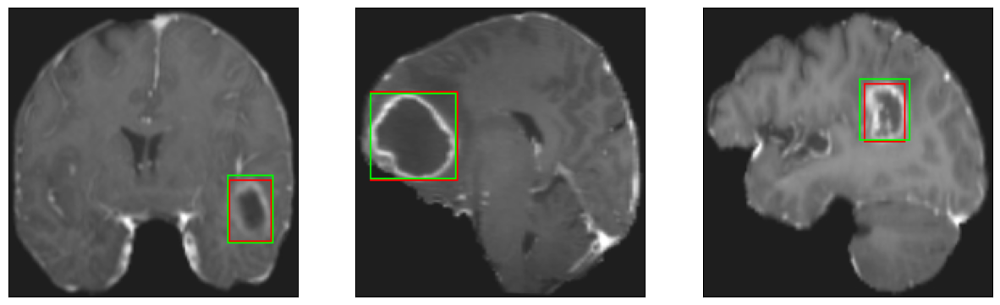

52/52 [==============================] - 7s 127ms/step - loss: 2.3823 - IoU: 0.7742 - val_loss: 4.0573 - val_IoU: 0.7209
Epoch 111/150
52/52 [==============================] - ETA: 0s - loss: 2.3497 - IoU: 0.7848
Epoch 111: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 34ms/step


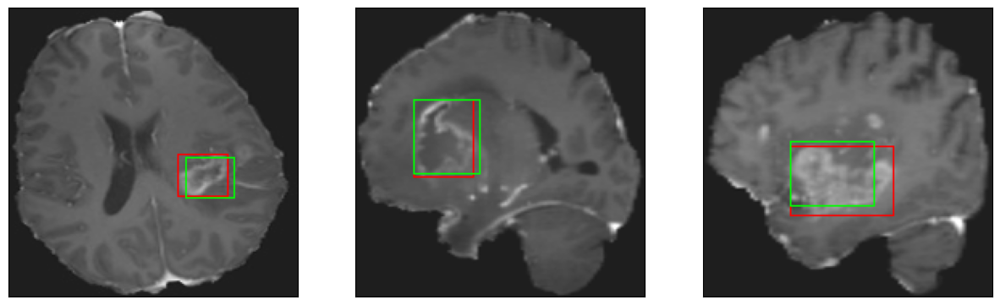

52/52 [==============================] - 7s 144ms/step - loss: 2.3497 - IoU: 0.7848 - val_loss: 4.3623 - val_IoU: 0.6698
Epoch 112/150
52/52 [==============================] - ETA: 0s - loss: 2.2291 - IoU: 0.7920
Epoch 112: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 30ms/step


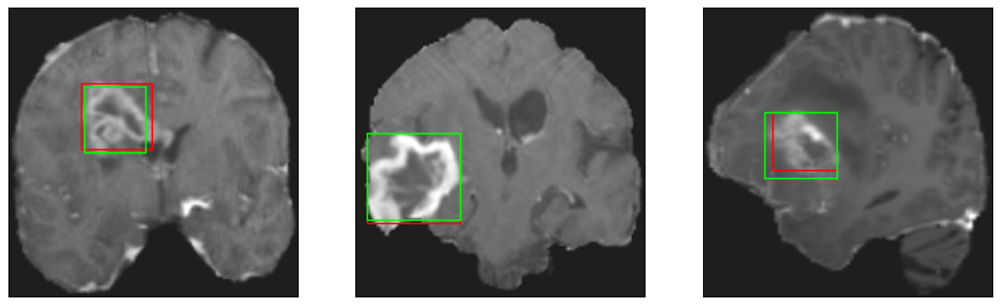

52/52 [==============================] - 7s 130ms/step - loss: 2.2291 - IoU: 0.7920 - val_loss: 4.2074 - val_IoU: 0.7028
Epoch 113/150
52/52 [==============================] - ETA: 0s - loss: 2.3305 - IoU: 0.7902
Epoch 113: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


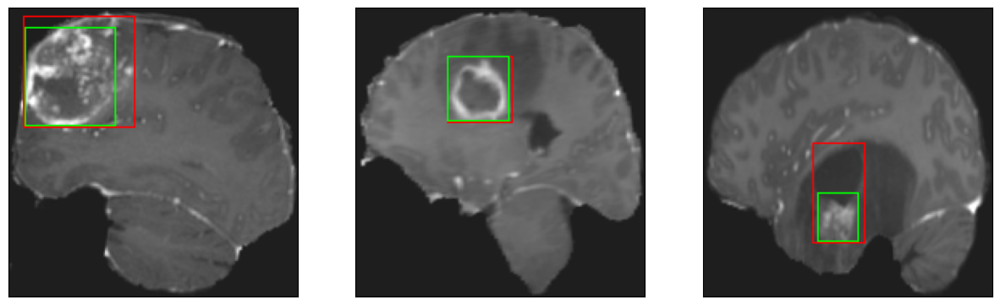

52/52 [==============================] - 8s 146ms/step - loss: 2.3305 - IoU: 0.7902 - val_loss: 4.2435 - val_IoU: 0.7003
Epoch 114/150
52/52 [==============================] - ETA: 0s - loss: 2.3571 - IoU: 0.7832
Epoch 114: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


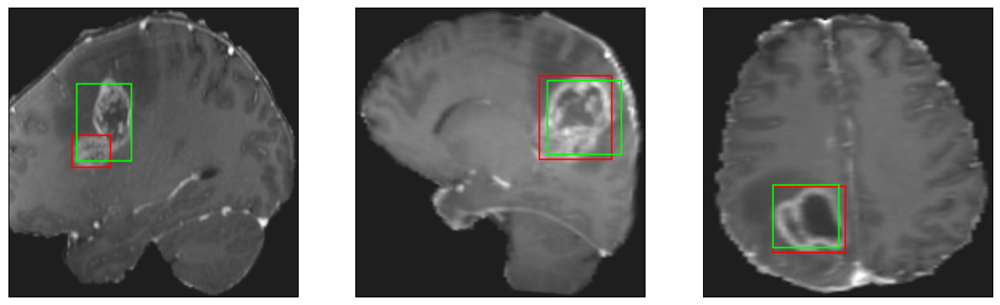

52/52 [==============================] - 7s 139ms/step - loss: 2.3571 - IoU: 0.7832 - val_loss: 4.1972 - val_IoU: 0.6951
Epoch 115/150
52/52 [==============================] - ETA: 0s - loss: 2.2858 - IoU: 0.7863
Epoch 115: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 34ms/step


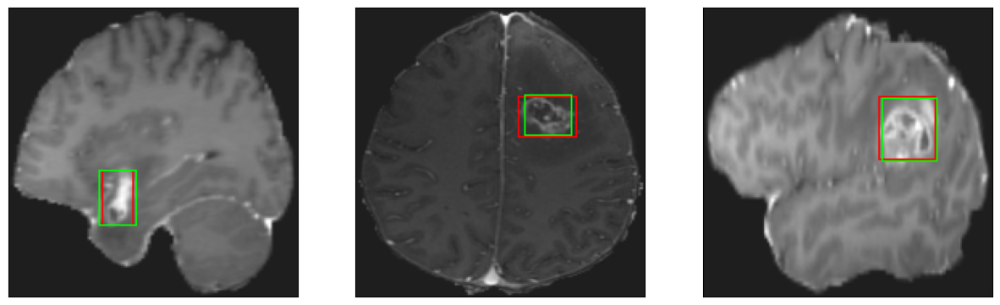

52/52 [==============================] - 8s 145ms/step - loss: 2.2858 - IoU: 0.7863 - val_loss: 4.1273 - val_IoU: 0.7041
Epoch 116/150
52/52 [==============================] - ETA: 0s - loss: 2.3046 - IoU: 0.7840
Epoch 116: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


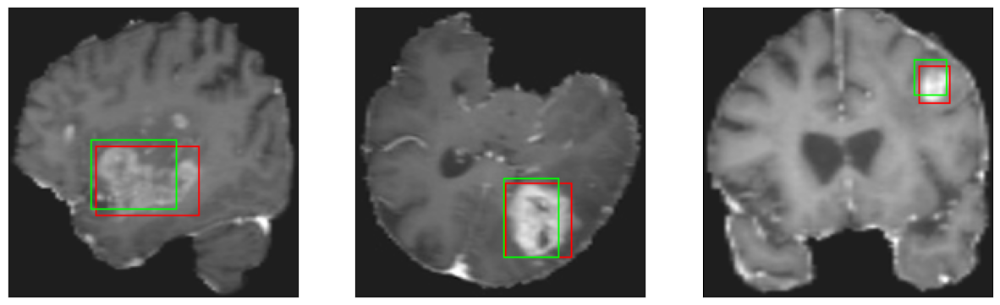

52/52 [==============================] - 7s 132ms/step - loss: 2.3046 - IoU: 0.7840 - val_loss: 4.2914 - val_IoU: 0.6540
Epoch 117/150
52/52 [==============================] - ETA: 0s - loss: 2.3708 - IoU: 0.7774
Epoch 117: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 32ms/step


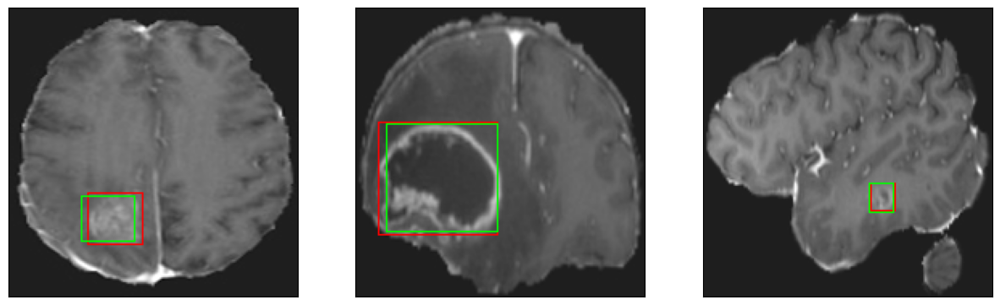

52/52 [==============================] - 8s 151ms/step - loss: 2.3708 - IoU: 0.7774 - val_loss: 4.1156 - val_IoU: 0.6973
Epoch 118/150
52/52 [==============================] - ETA: 0s - loss: 2.3654 - IoU: 0.7814
Epoch 118: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 33ms/step


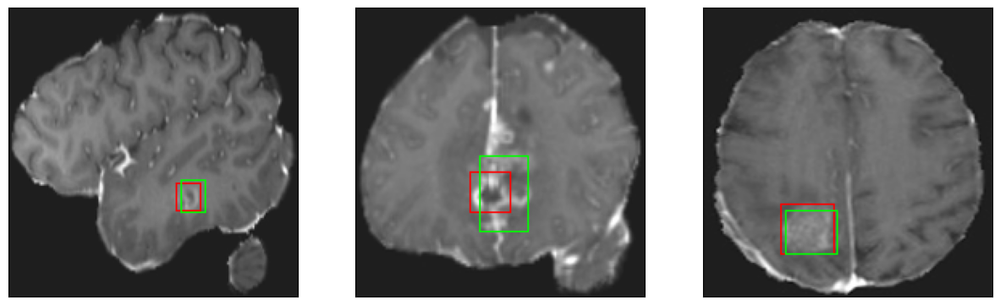

52/52 [==============================] - 7s 132ms/step - loss: 2.3654 - IoU: 0.7814 - val_loss: 4.1550 - val_IoU: 0.6935
Epoch 119/150
52/52 [==============================] - ETA: 0s - loss: 2.3189 - IoU: 0.7806
Epoch 119: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 31ms/step


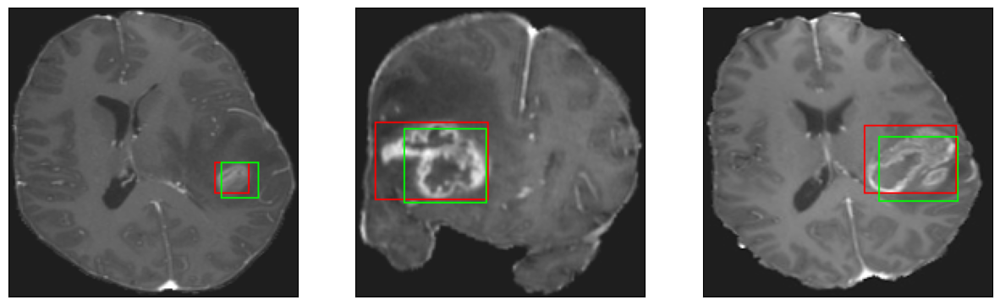

52/52 [==============================] - 7s 130ms/step - loss: 2.3189 - IoU: 0.7806 - val_loss: 4.0030 - val_IoU: 0.6933
Epoch 120/150
52/52 [==============================] - ETA: 0s - loss: 2.2562 - IoU: 0.7889
Epoch 120: val_loss did not improve from 3.99449
8/8 [==============================] - 0s 30ms/step


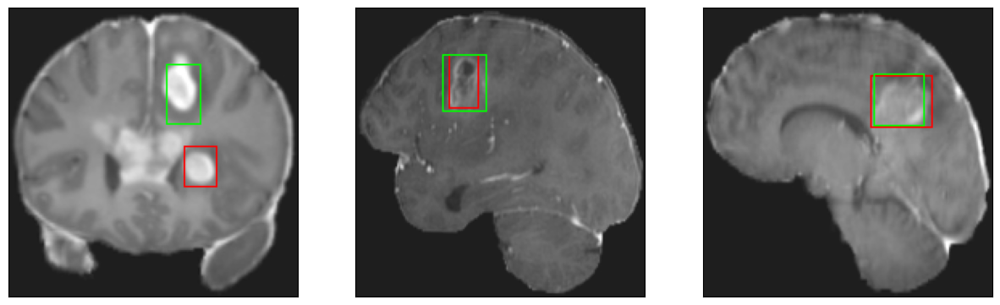

52/52 [==============================] - 7s 142ms/step - loss: 2.2562 - IoU: 0.7889 - val_loss: 4.2398 - val_IoU: 0.6892
Epoch 121/150
52/52 [==============================] - ETA: 0s - loss: 2.2727 - IoU: 0.7883
Epoch 121: val_loss improved from 3.99449 to 3.98036, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


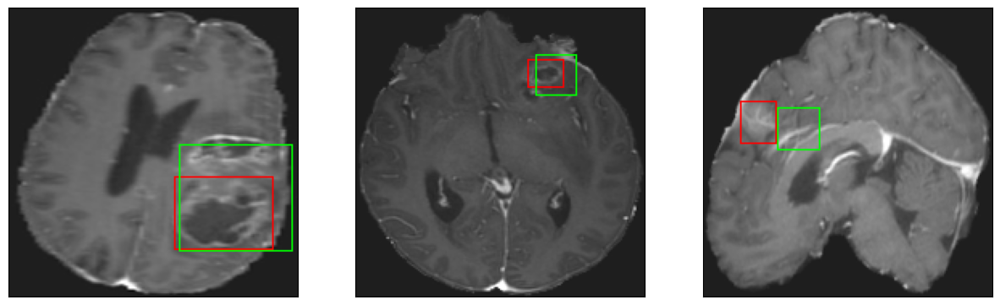

52/52 [==============================] - 10s 186ms/step - loss: 2.2727 - IoU: 0.7883 - val_loss: 3.9804 - val_IoU: 0.7162
Epoch 122/150
52/52 [==============================] - ETA: 0s - loss: 2.3088 - IoU: 0.7849
Epoch 122: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 34ms/step


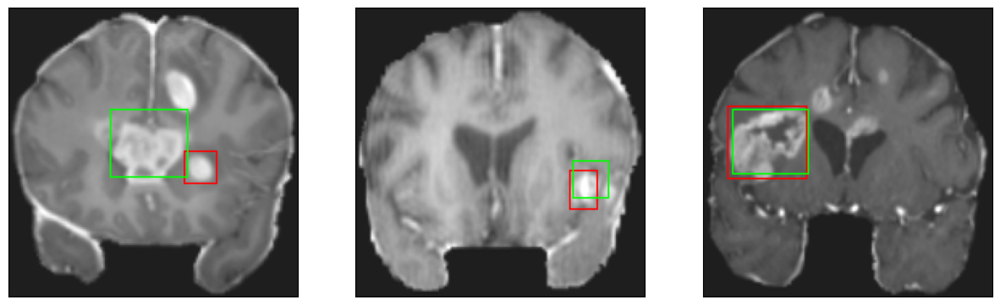

52/52 [==============================] - 7s 141ms/step - loss: 2.3088 - IoU: 0.7849 - val_loss: 4.0784 - val_IoU: 0.7100
Epoch 123/150
52/52 [==============================] - ETA: 0s - loss: 2.2108 - IoU: 0.7961
Epoch 123: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 31ms/step


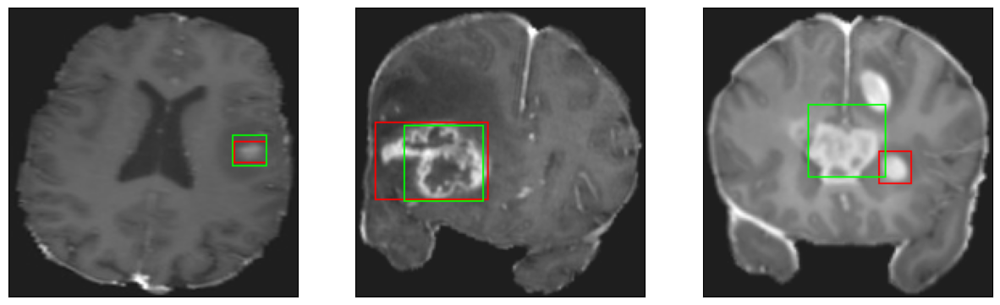

52/52 [==============================] - 7s 132ms/step - loss: 2.2108 - IoU: 0.7961 - val_loss: 4.0129 - val_IoU: 0.7093
Epoch 124/150
52/52 [==============================] - ETA: 0s - loss: 2.1990 - IoU: 0.7961
Epoch 124: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 31ms/step


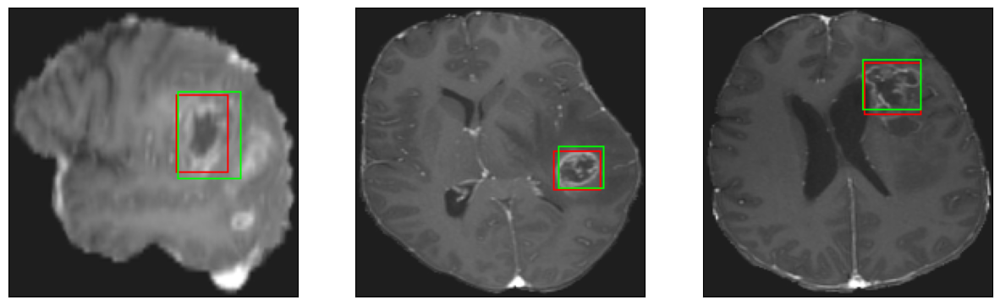

52/52 [==============================] - 8s 149ms/step - loss: 2.1990 - IoU: 0.7961 - val_loss: 4.0337 - val_IoU: 0.7158
Epoch 125/150
52/52 [==============================] - ETA: 0s - loss: 2.2353 - IoU: 0.7922
Epoch 125: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 33ms/step


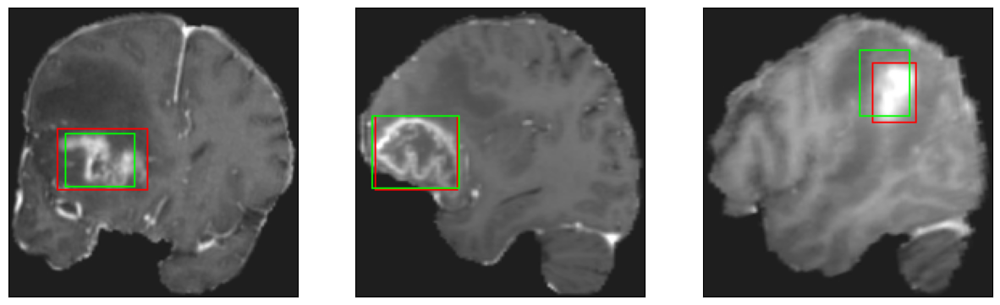

52/52 [==============================] - 7s 132ms/step - loss: 2.2353 - IoU: 0.7922 - val_loss: 4.5771 - val_IoU: 0.6735
Epoch 126/150
52/52 [==============================] - ETA: 0s - loss: 2.2584 - IoU: 0.7926
Epoch 126: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 32ms/step


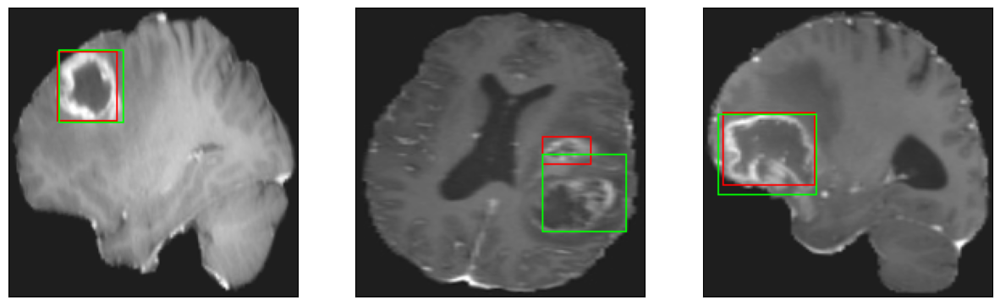

52/52 [==============================] - 7s 133ms/step - loss: 2.2584 - IoU: 0.7926 - val_loss: 4.1771 - val_IoU: 0.7103
Epoch 127/150
52/52 [==============================] - ETA: 0s - loss: 2.1914 - IoU: 0.8024
Epoch 127: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 31ms/step


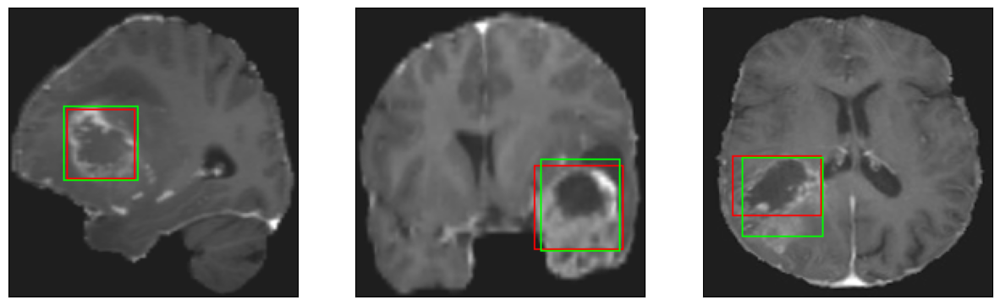

52/52 [==============================] - 8s 146ms/step - loss: 2.1914 - IoU: 0.8024 - val_loss: 4.0776 - val_IoU: 0.7212
Epoch 128/150
52/52 [==============================] - ETA: 0s - loss: 2.2050 - IoU: 0.8002
Epoch 128: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 32ms/step


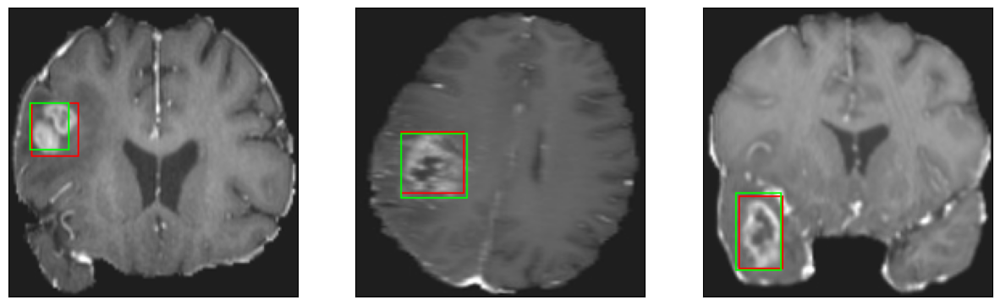

52/52 [==============================] - 7s 130ms/step - loss: 2.2050 - IoU: 0.8002 - val_loss: 4.1158 - val_IoU: 0.7018
Epoch 129/150
52/52 [==============================] - ETA: 0s - loss: 2.3156 - IoU: 0.7779
Epoch 129: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 32ms/step


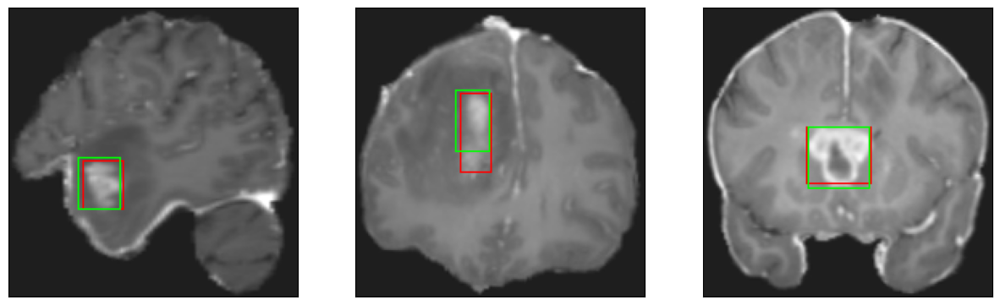

52/52 [==============================] - 8s 150ms/step - loss: 2.3156 - IoU: 0.7779 - val_loss: 4.1640 - val_IoU: 0.7210
Epoch 130/150
52/52 [==============================] - ETA: 0s - loss: 2.2563 - IoU: 0.7954
Epoch 130: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 31ms/step


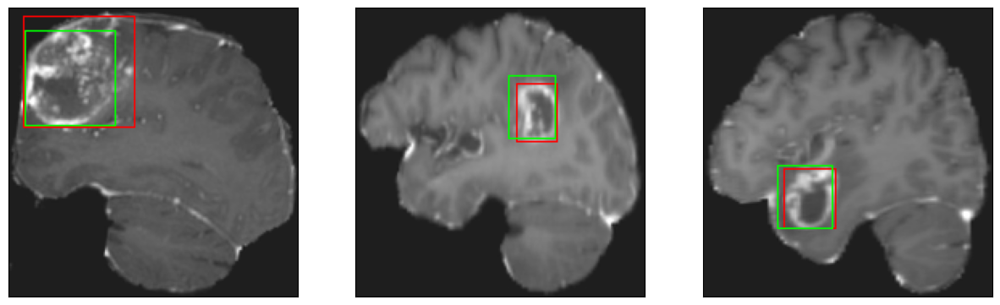

52/52 [==============================] - 7s 127ms/step - loss: 2.2563 - IoU: 0.7954 - val_loss: 4.1718 - val_IoU: 0.6920
Epoch 131/150
52/52 [==============================] - ETA: 0s - loss: 2.1517 - IoU: 0.7988
Epoch 131: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 32ms/step


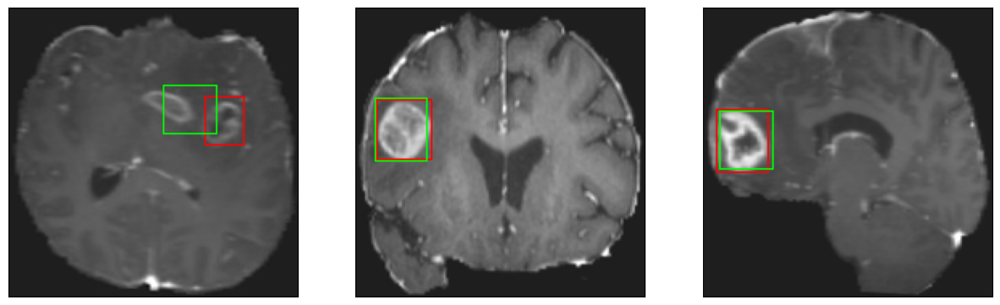

52/52 [==============================] - 7s 141ms/step - loss: 2.1517 - IoU: 0.7988 - val_loss: 4.2849 - val_IoU: 0.6776
Epoch 132/150
52/52 [==============================] - ETA: 0s - loss: 2.2362 - IoU: 0.7958
Epoch 132: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 34ms/step


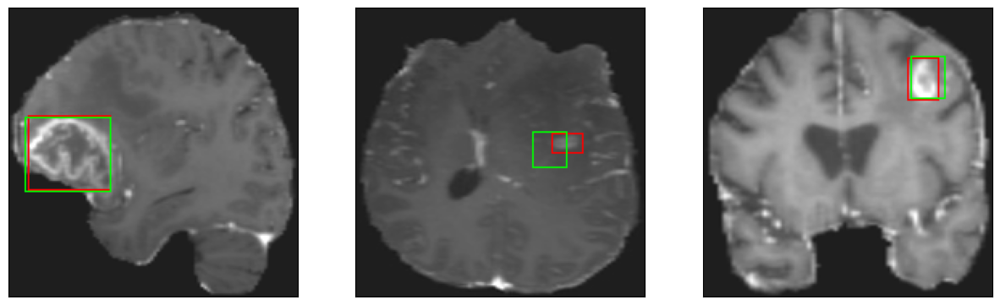

52/52 [==============================] - 7s 137ms/step - loss: 2.2362 - IoU: 0.7958 - val_loss: 4.0926 - val_IoU: 0.7240
Epoch 133/150
52/52 [==============================] - ETA: 0s - loss: 2.2818 - IoU: 0.7927
Epoch 133: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 31ms/step


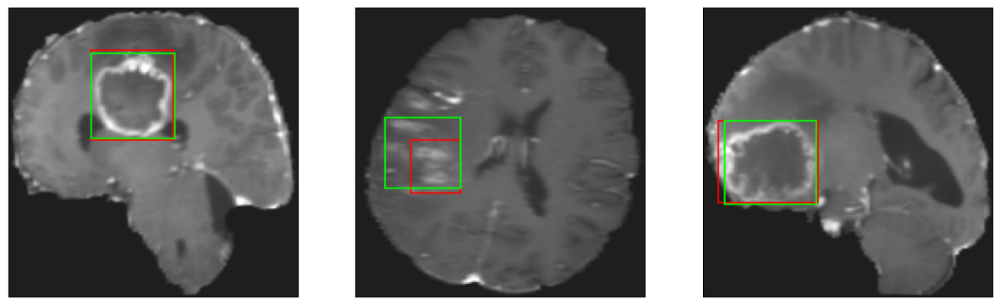

52/52 [==============================] - 7s 141ms/step - loss: 2.2818 - IoU: 0.7927 - val_loss: 4.1020 - val_IoU: 0.7204
Epoch 134/150
52/52 [==============================] - ETA: 0s - loss: 2.1955 - IoU: 0.8007
Epoch 134: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 32ms/step


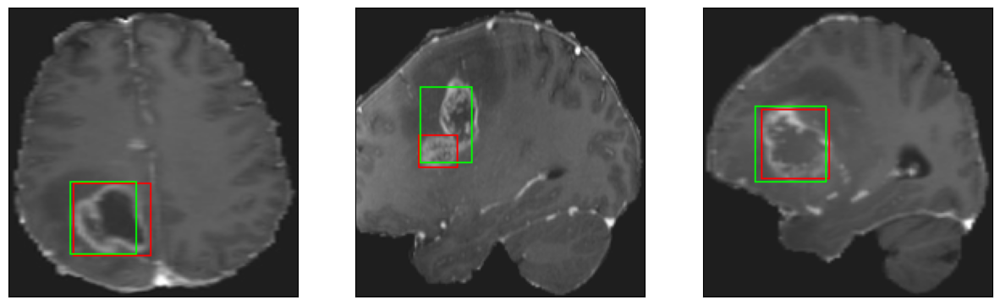

52/52 [==============================] - 7s 133ms/step - loss: 2.1955 - IoU: 0.8007 - val_loss: 4.2606 - val_IoU: 0.6856
Epoch 135/150
52/52 [==============================] - ETA: 0s - loss: 2.1397 - IoU: 0.8024
Epoch 135: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 31ms/step


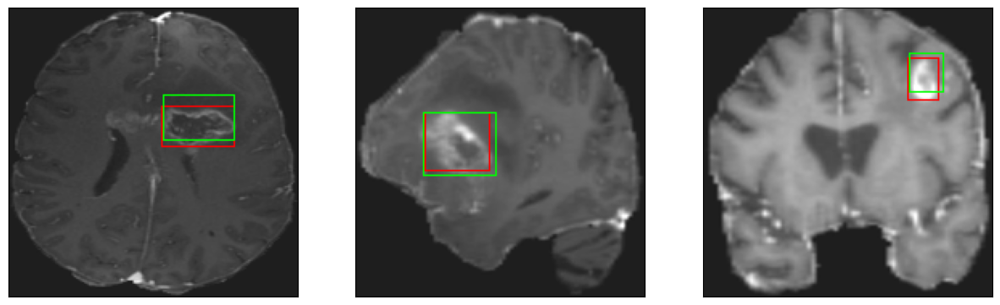

52/52 [==============================] - 7s 133ms/step - loss: 2.1397 - IoU: 0.8024 - val_loss: 4.2832 - val_IoU: 0.6996
Epoch 136/150
52/52 [==============================] - ETA: 0s - loss: 2.2449 - IoU: 0.7898
Epoch 136: val_loss did not improve from 3.98036
8/8 [==============================] - 0s 32ms/step


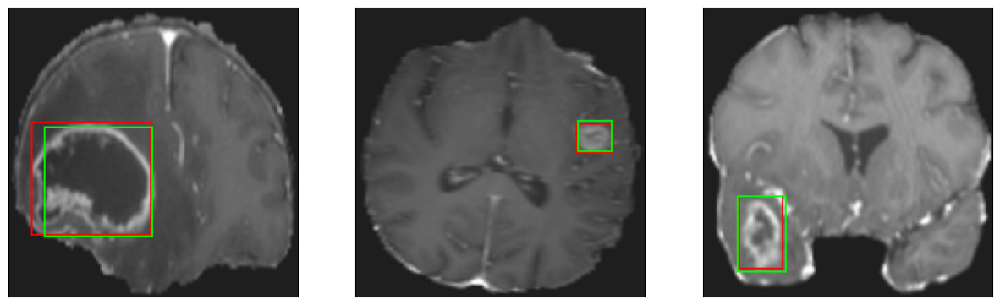

52/52 [==============================] - 7s 137ms/step - loss: 2.2449 - IoU: 0.7898 - val_loss: 4.1641 - val_IoU: 0.6947
Epoch 137/150
52/52 [==============================] - ETA: 0s - loss: 2.2069 - IoU: 0.8005
Epoch 137: val_loss improved from 3.98036 to 3.95466, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


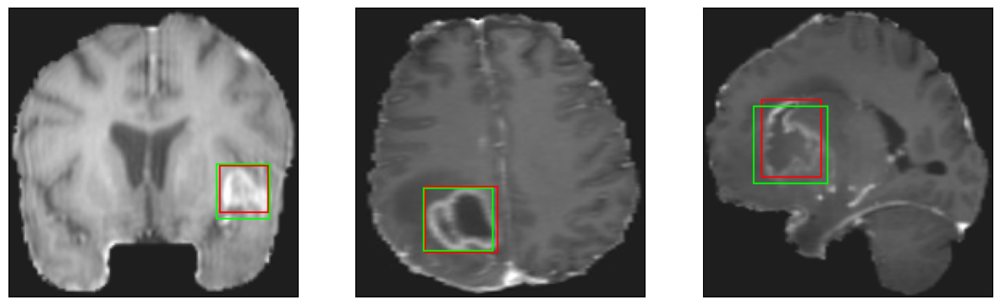

52/52 [==============================] - 10s 190ms/step - loss: 2.2069 - IoU: 0.8005 - val_loss: 3.9547 - val_IoU: 0.7198
Epoch 138/150
52/52 [==============================] - ETA: 0s - loss: 2.2318 - IoU: 0.7902
Epoch 138: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


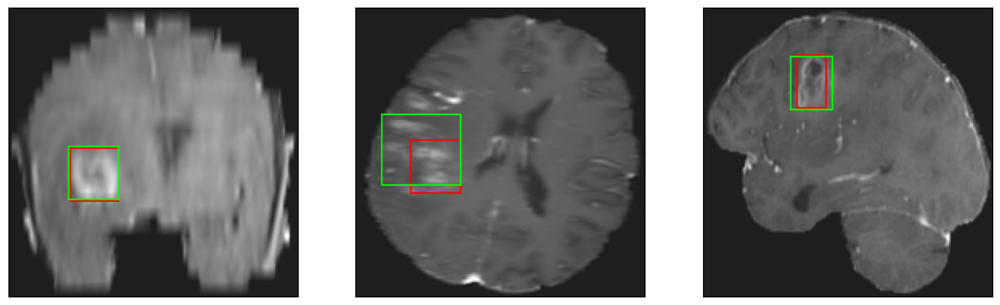

52/52 [==============================] - 7s 130ms/step - loss: 2.2318 - IoU: 0.7902 - val_loss: 4.0774 - val_IoU: 0.7037
Epoch 139/150
52/52 [==============================] - ETA: 0s - loss: 2.1337 - IoU: 0.8073
Epoch 139: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


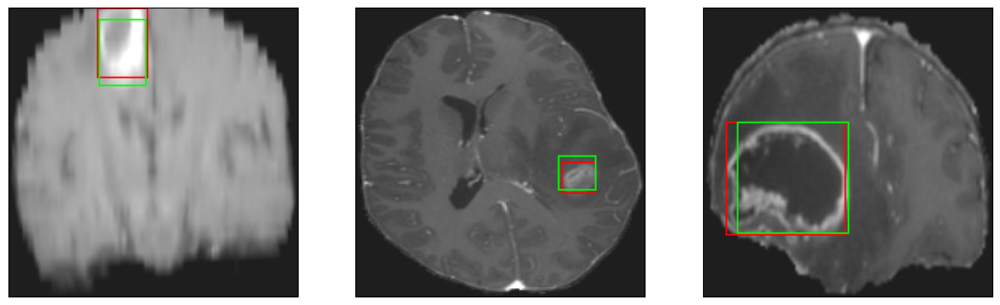

52/52 [==============================] - 7s 137ms/step - loss: 2.1337 - IoU: 0.8073 - val_loss: 4.0559 - val_IoU: 0.7106
Epoch 140/150
52/52 [==============================] - ETA: 0s - loss: 2.0593 - IoU: 0.8137
Epoch 140: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


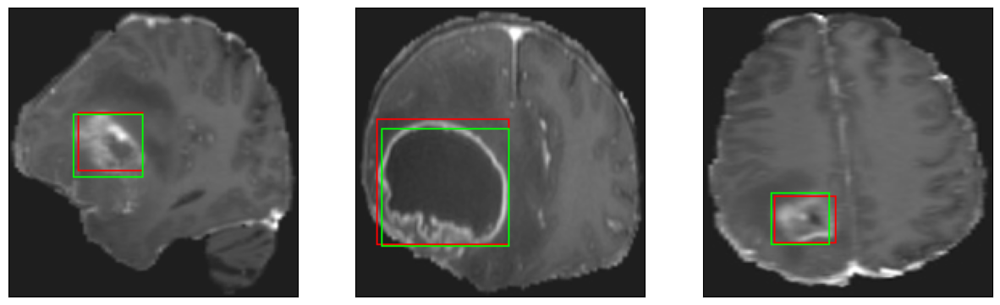

52/52 [==============================] - 8s 148ms/step - loss: 2.0593 - IoU: 0.8137 - val_loss: 4.0092 - val_IoU: 0.7104
Epoch 141/150
52/52 [==============================] - ETA: 0s - loss: 2.2168 - IoU: 0.7925
Epoch 141: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 32ms/step


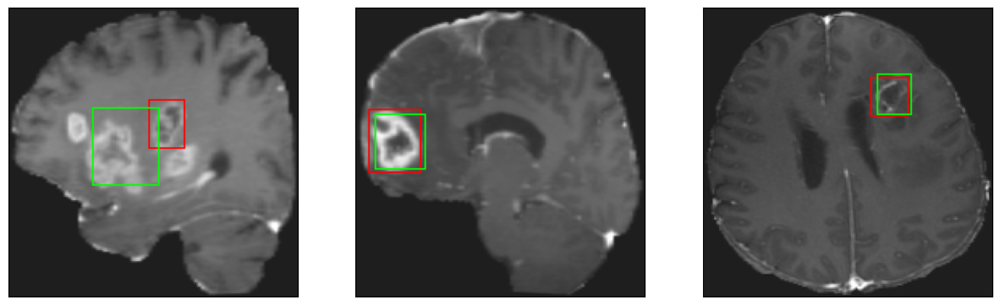

52/52 [==============================] - 7s 128ms/step - loss: 2.2168 - IoU: 0.7925 - val_loss: 4.0494 - val_IoU: 0.7149
Epoch 142/150
52/52 [==============================] - ETA: 0s - loss: 2.1838 - IoU: 0.7963
Epoch 142: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


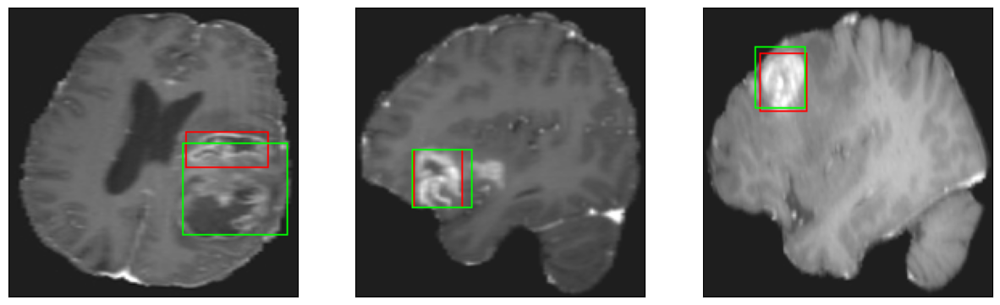

52/52 [==============================] - 7s 141ms/step - loss: 2.1838 - IoU: 0.7963 - val_loss: 4.0549 - val_IoU: 0.7049
Epoch 143/150
52/52 [==============================] - ETA: 0s - loss: 2.1385 - IoU: 0.8086
Epoch 143: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 32ms/step


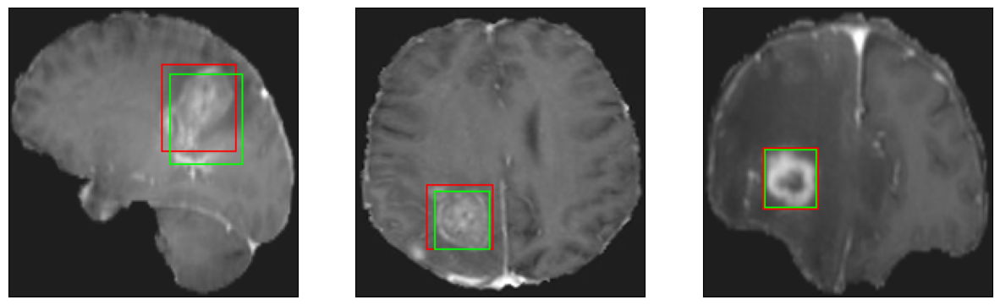

52/52 [==============================] - 8s 146ms/step - loss: 2.1385 - IoU: 0.8086 - val_loss: 4.1623 - val_IoU: 0.7114
Epoch 144/150
52/52 [==============================] - ETA: 0s - loss: 2.2067 - IoU: 0.7927
Epoch 144: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


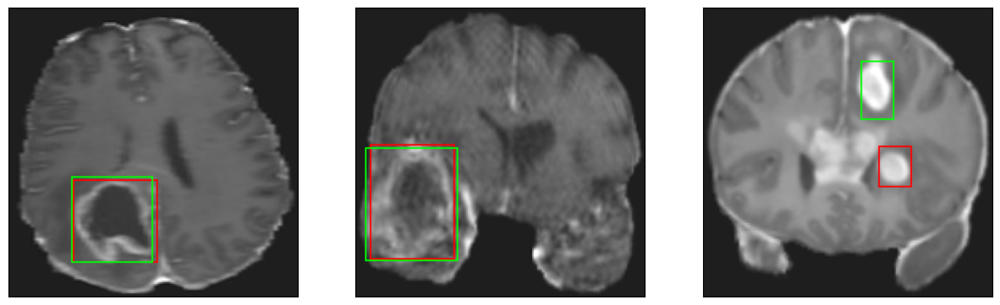

52/52 [==============================] - 8s 149ms/step - loss: 2.2067 - IoU: 0.7927 - val_loss: 4.1789 - val_IoU: 0.6955
Epoch 145/150
52/52 [==============================] - ETA: 0s - loss: 2.2450 - IoU: 0.7921
Epoch 145: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 32ms/step


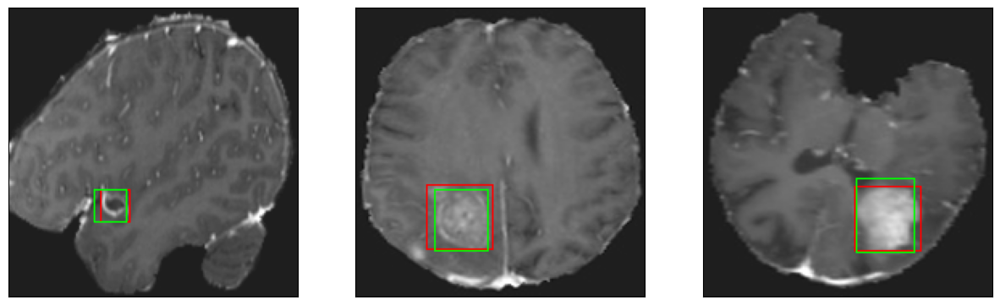

52/52 [==============================] - 7s 128ms/step - loss: 2.2450 - IoU: 0.7921 - val_loss: 4.2022 - val_IoU: 0.7101
Epoch 146/150
52/52 [==============================] - ETA: 0s - loss: 2.1854 - IoU: 0.7979
Epoch 146: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


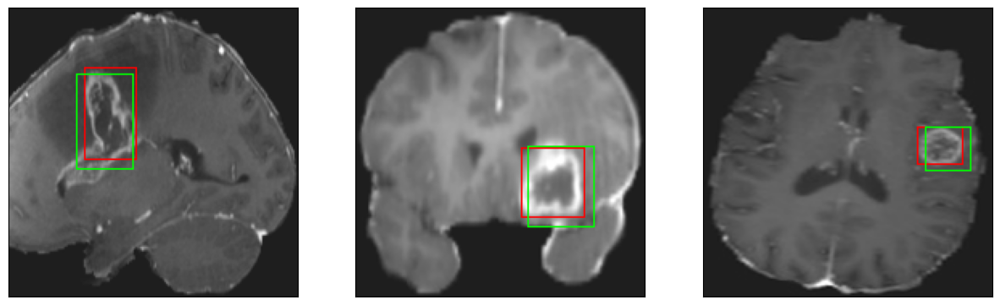

52/52 [==============================] - 8s 144ms/step - loss: 2.1854 - IoU: 0.7979 - val_loss: 4.4788 - val_IoU: 0.6496
Epoch 147/150
52/52 [==============================] - ETA: 0s - loss: 2.2924 - IoU: 0.7908
Epoch 147: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 30ms/step


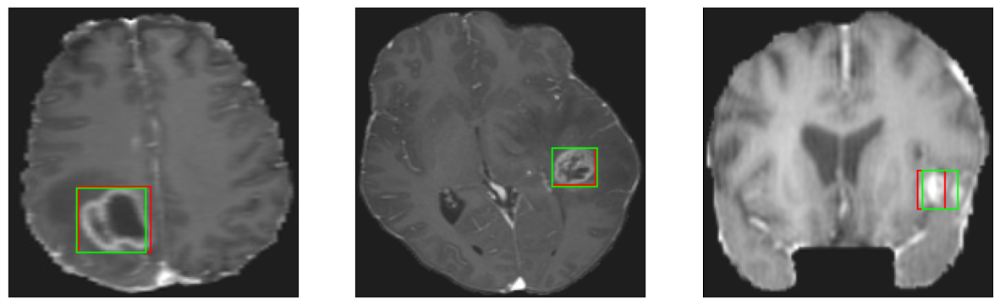

52/52 [==============================] - 7s 128ms/step - loss: 2.2924 - IoU: 0.7908 - val_loss: 3.9692 - val_IoU: 0.7211
Epoch 148/150
52/52 [==============================] - ETA: 0s - loss: 2.1194 - IoU: 0.7998
Epoch 148: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


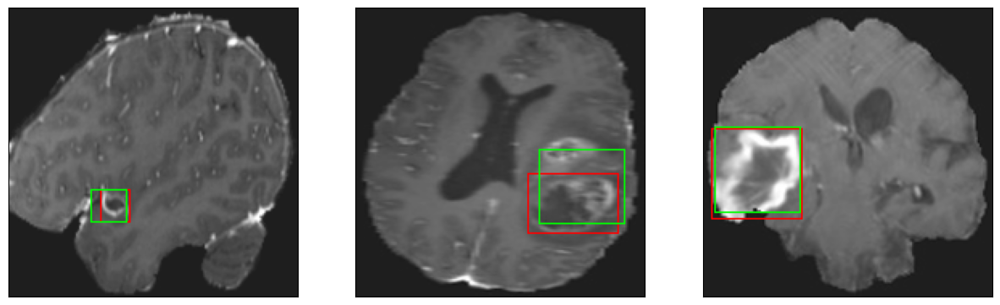

52/52 [==============================] - 7s 142ms/step - loss: 2.1194 - IoU: 0.7998 - val_loss: 4.0693 - val_IoU: 0.7096
Epoch 149/150
52/52 [==============================] - ETA: 0s - loss: 2.1483 - IoU: 0.7973
Epoch 149: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 34ms/step


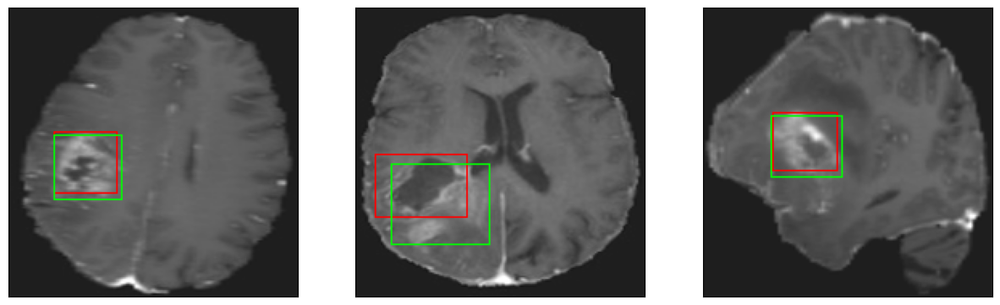

52/52 [==============================] - 7s 136ms/step - loss: 2.1483 - IoU: 0.7973 - val_loss: 4.0546 - val_IoU: 0.7218
Epoch 150/150
52/52 [==============================] - ETA: 0s - loss: 2.1265 - IoU: 0.8078
Epoch 150: val_loss did not improve from 3.95466
8/8 [==============================] - 0s 31ms/step


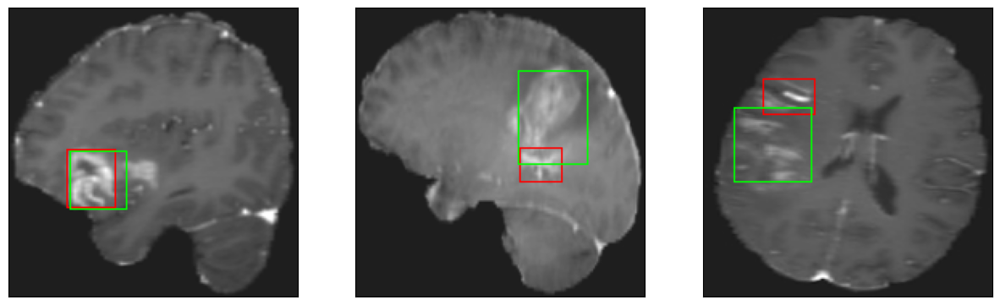

52/52 [==============================] - 7s 143ms/step - loss: 2.1265 - IoU: 0.8078 - val_loss: 3.9941 - val_IoU: 0.7266


In [26]:
hist = model.fit(
        train_dataset,
        epochs=150,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

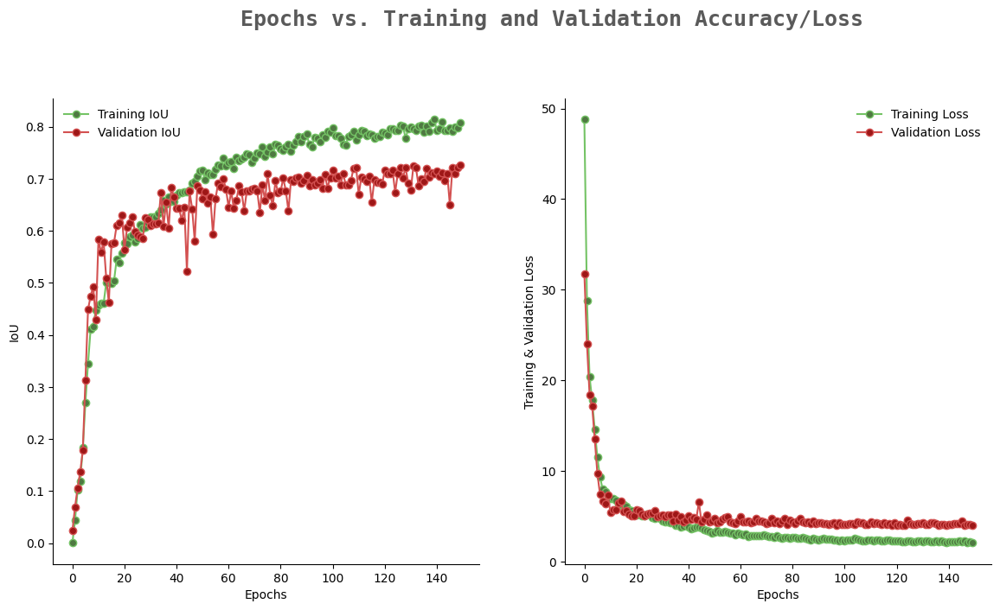

In [29]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(150)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [30]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_EFFNET/model_EFFNET.h5',compile = False)

In [31]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [32]:
model.evaluate(test_dataset)

15/15 [==============================] - 3s 37ms/step - loss: 4.5609 - IoU: 0.6887


[4.560912132263184, 0.6887375116348267]